<a href="https://colab.research.google.com/github/Vizor97/AIOS-MARKETING/blob/main/Manulife_EDA_DS_Jul04.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install openpyxl

In [ ]:
!pip install sweetviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.1/15.1 MB 59.8 MB/s eta 0:00:00


 **Recommend** using 'statsmodel' library in python- use linear regression just to

 **learn** which features could be correlated and stats sign. Instead of predicting the sales value, try to predict if a sales will happen using classification.

 **Try** to use XGboost or a tree model

 **Try** SHAP - Welcome to the SHAP documentation — SHAP latest documentation https://shap.readthedocs.io/en/latest/index.html

 **Instead** of one hot coding - perform transformative function on the data

 **Now** that we have segment variables, one question we should aim to answer - who is the person in the mass market you would call first? Fine tune the model - they are the ones with the least amount of data but the ones we want to know the most.

 **Feedback**: My primary feedback here is on model selection: I'm not sure how you intend to solve your stated goal (attribution of sales from marketing) using the models you suggested you might try (like ARIMA).

  **A** stronger link between goal & model + a more focused approach on your models will increase your chance of success here.

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.manifold import TSNE
from scipy import stats
import scipy.cluster.hierarchy as sch
pd.set_option('display.max_rows', None)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# df=pd.read_excel('capstone_queens_to_share.xlsx')
df = pd.read_excel("/content/drive/MyDrive/Data/capstone_queens_to_share.xlsx")
df.head()
df.shape
# df['yr_mth'] = df['year'].astype(str) + '-' + df['month'].astype(str)
# df['unique_month_id'] = df['yr_mth'].astype('category').cat.codes

(398556, 10)

In [ ]:
distinct_hash_party_count1 = df['hash_party_id'].nunique()
total_hash_party_count1 = df['hash_party_id'].count()

print(f"Distinct hash_party_id count: {distinct_hash_party_count1}")
print(f"Total hash_party_id count: {total_hash_party_count1}")

Distinct hash_party_id count: 29068
Total hash_party_id count: 398556


In [ ]:
df_seg = pd.read_csv("/content/drive/MyDrive/Data/capstone_queens_segments.csv")
df_seg.head()

,hash_party_id,segment,mass_market
0,9544a65ba4f170e58d4c7ce061e4c77f14ce3ce9098383...,Strong Supporter,0.0
1,51de815f9974349e328000b999b8d162f68298c826c31d...,Non 10/4,0.0
2,561ab5dbc04d499fe09af2f3da89839947690aa90cad0f...,.10/4,0.0
3,e90f8a76246bf800009d10d2fae5d9a7b2825c28591132...,.10/4,0.0
4,cd3cbfa41215bb9cc7ade4a8c3fcd11c8d37d498c19a99...,Non 10/4,0.0


In [ ]:
distinct_hash_party_count2 = df_seg['hash_party_id'].nunique()
total_hash_party_count2 = df_seg['hash_party_id'].count()

print(f"Distinct hash_party_id count: {distinct_hash_party_count2}")
print(f"Total hash_party_id count: {total_hash_party_count2}")

Distinct hash_party_id count: 29068
Total hash_party_id count: 29068


In [ ]:
df['yr_mth'] = df['year'].astype(str) + df['month'].astype(str).str.zfill(2)
df['yr_mth'] = df['yr_mth'].astype(int)
df.head()



,month,year,event_type,non_cash_event_count,month_seasonal_effect,campaign_enabled,unique_month_id,hash_party_id,cash_value,cash_event_counts,yr_mth
0,1,2019,Written,0,1.000000,0,1,9544a65ba4f170e58d4c7ce061e4c77f14ce3ce9098383...,1852.199992,4,201901
1,3,2019,Written,0,1.500000,0,3,51de815f9974349e328000b999b8d162f68298c826c31d...,100.289998,2,201903
2,5,2019,Written,0,1.866025,0,5,561ab5dbc04d499fe09af2f3da89839947690aa90cad0f...,113.689997,4,201905
3,5,2019,Written,0,1.866025,0,5,e90f8a76246bf800009d10d2fae5d9a7b2825c28591132...,555.010010,4,201905
4,7,2019,Written,0,2.000000,0,7,cd3cbfa41215bb9cc7ade4a8c3fcd11c8d37d498c19a99...,849.470011,18,201907


In [ ]:
yr_mth_counts = df.groupby('yr_mth').size().reset_index(name='count')
# yr_mth_counts

In [ ]:
df = df[df['year'] != 2024]

**Option 1**

In [ ]:
# Keeping specific columns and pivoting
df_pivot = df.pivot_table(index=['hash_party_id'],
                          columns=['event_type', 'yr_mth'],
                          values=['non_cash_event_count', 'month_seasonal_effect', 'campaign_enabled', 'unique_month_id', 'cash_value', 'cash_event_counts'],
                          fill_value=0)

# Flatten the MultiIndex columns
df_pivot.columns = ['_'.join([str(i) for i in col]).strip() for col in df_pivot.columns.values]

# Reset index to turn multi-index into columns
df_pivot.reset_index(inplace=True)

In [ ]:
df_pivot.head()

,hash_party_id,campaign_enabled_Lead_acted_202301,campaign_enabled_Lead_acted_202302,campaign_enabled_Lead_acted_202303,campaign_enabled_Lead_acted_202304,campaign_enabled_Lead_acted_202305,campaign_enabled_Lead_acted_202306,campaign_enabled_Lead_acted_202307,campaign_enabled_Lead_acted_202308,campaign_enabled_Lead_acted_202309,...,unique_month_id_Written_202303,unique_month_id_Written_202304,unique_month_id_Written_202305,unique_month_id_Written_202306,unique_month_id_Written_202307,unique_month_id_Written_202308,unique_month_id_Written_202309,unique_month_id_Written_202310,unique_month_id_Written_202311,unique_month_id_Written_202312
0,0005beeed89efc9d458ef12143612942a0a0fc1cd89131...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,000a09eac5575dd9fba6fcdba4967a8ce336a90bb15cab...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,000d0a991a0e1da99b46c98fffb82797f8590a1ae93573...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,000eb3c1db47968d465bcd2c2eaa227d76d51363f9e836...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0011b47873ff50a107bcead16f1b95ed129562b6be1fdb...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
distinct_hash_party_count3= df_pivot['hash_party_id'].nunique()
total_hash_party_count3= df_pivot['hash_party_id'].count()

print(f"Distinct hash_party_id count: {distinct_hash_party_count3}")
print(f"Total hash_party_id count: {total_hash_party_count3}")

Distinct hash_party_id count: 27366
Total hash_party_id count: 27366


In [ ]:
df_pivot.to_csv('df_pivot_0710.csv', index=False)

In [ ]:
print(df_pivot.columns)

Index(['hash_party_id', 'campaign_enabled_Lead_acted_202301',
       'campaign_enabled_Lead_acted_202302',
       'campaign_enabled_Lead_acted_202303',
       'campaign_enabled_Lead_acted_202304',
       'campaign_enabled_Lead_acted_202305',
       'campaign_enabled_Lead_acted_202306',
       'campaign_enabled_Lead_acted_202307',
       'campaign_enabled_Lead_acted_202308',
       'campaign_enabled_Lead_acted_202309',
       ...
       'unique_month_id_Written_202307', 'unique_month_id_Written_202308',
       'unique_month_id_Written_202309', 'unique_month_id_Written_202310',
       'unique_month_id_Written_202311', 'unique_month_id_Written_202312',
       'unique_month_id_Written_202401', 'unique_month_id_Written_202402',
       'unique_month_id_Written_202403', 'unique_month_id_Written_202404'],
      dtype='object', length=1231)


**Option** **2**

In [ ]:
# Keeping specific columns and pivoting
df_pivot2 = df.pivot_table(index=['hash_party_id','yr_mth','year'],
                          columns=['event_type'],
                          values=['non_cash_event_count', 'month_seasonal_effect', 'campaign_enabled', 'unique_month_id', 'cash_value', 'cash_event_counts'],
                          fill_value=0)

# Flatten the MultiIndex columns
df_pivot2.columns = ['_'.join([str(i) for i in col]).strip() for col in df_pivot2.columns.values]

# Reset index to turn multi-index into columns
df_pivot2.reset_index(inplace=True)

In [ ]:
df_pivot2.head()

,hash_party_id,yr_mth,year,campaign_enabled_Lead_acted,campaign_enabled_Lead_given,campaign_enabled_Sales,campaign_enabled_Touchpoint,campaign_enabled_Written,cash_event_counts_Lead_acted,cash_event_counts_Lead_given,...,non_cash_event_count_Lead_acted,non_cash_event_count_Lead_given,non_cash_event_count_Sales,non_cash_event_count_Touchpoint,non_cash_event_count_Written,unique_month_id_Lead_acted,unique_month_id_Lead_given,unique_month_id_Sales,unique_month_id_Touchpoint,unique_month_id_Written
0,0005beeed89efc9d458ef12143612942a0a0fc1cd89131...,201902,2019,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,2,0,0
1,0005beeed89efc9d458ef12143612942a0a0fc1cd89131...,201903,2019,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,3,0,0
2,0005beeed89efc9d458ef12143612942a0a0fc1cd89131...,201904,2019,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
3,0005beeed89efc9d458ef12143612942a0a0fc1cd89131...,201905,2019,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,5,0,5
4,0005beeed89efc9d458ef12143612942a0a0fc1cd89131...,201907,2019,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,7,0,0


In [ ]:
distinct_hash_party_count4= df_pivot2['hash_party_id'].nunique()
total_hash_party_count4= df_pivot2['hash_party_id'].count()

print(f"Distinct hash_party_id count: {distinct_hash_party_count4}")
print(f"Total hash_party_id count: {total_hash_party_count4}")

Distinct hash_party_id count: 27366
Total hash_party_id count: 264537


In [ ]:
print(df_pivot2.columns)

Index(['hash_party_id', 'yr_mth', 'year', 'campaign_enabled_Lead_acted',
       'campaign_enabled_Lead_given', 'campaign_enabled_Sales',
       'campaign_enabled_Touchpoint', 'campaign_enabled_Written',
       'cash_event_counts_Lead_acted', 'cash_event_counts_Lead_given',
       'cash_event_counts_Sales', 'cash_event_counts_Touchpoint',
       'cash_event_counts_Written', 'cash_value_Lead_acted',
       'cash_value_Lead_given', 'cash_value_Sales', 'cash_value_Touchpoint',
       'cash_value_Written', 'month_seasonal_effect_Lead_acted',
       'month_seasonal_effect_Lead_given', 'month_seasonal_effect_Sales',
       'month_seasonal_effect_Touchpoint', 'month_seasonal_effect_Written',
       'non_cash_event_count_Lead_acted', 'non_cash_event_count_Lead_given',
       'non_cash_event_count_Sales', 'non_cash_event_count_Touchpoint',
       'non_cash_event_count_Written', 'unique_month_id_Lead_acted',
       'unique_month_id_Lead_given', 'unique_month_id_Sales',
       'unique_month_id_Tou

In [ ]:
grouped_df = df_pivot2.groupby('hash_party_id').agg({
    'yr_mth': 'count',
    'month_seasonal_effect_Lead_acted': 'mean',
    'month_seasonal_effect_Lead_given': 'mean',
    'month_seasonal_effect_Sales': 'mean',
    'month_seasonal_effect_Touchpoint': 'mean',
    'month_seasonal_effect_Written': 'mean',
    'campaign_enabled_Lead_acted': 'sum',
    'campaign_enabled_Lead_given': 'sum',
    'campaign_enabled_Sales': 'sum',
    'campaign_enabled_Touchpoint': 'sum',
    'campaign_enabled_Written': 'sum',
    'cash_event_counts_Lead_acted': 'sum',
    'cash_event_counts_Lead_given': 'sum',
    'cash_event_counts_Sales': 'sum',
    'cash_event_counts_Touchpoint': 'sum',
    'cash_event_counts_Written': 'sum',
    'cash_value_Lead_acted': 'sum',
    'cash_value_Lead_given': 'sum',
    'cash_value_Sales': 'sum',
    'cash_value_Touchpoint': 'sum',
    'cash_value_Written': 'sum',
    'non_cash_event_count_Lead_acted': 'sum',
    'non_cash_event_count_Lead_given': 'sum',
    'non_cash_event_count_Sales': 'sum',
    'non_cash_event_count_Touchpoint': 'sum',
    'non_cash_event_count_Written': 'sum',
    'unique_month_id_Lead_acted': 'sum',
    'unique_month_id_Lead_given': 'sum',
    'unique_month_id_Sales': 'sum',
    'unique_month_id_Touchpoint': 'sum',
    'unique_month_id_Written': 'sum'
}).reset_index()


grouped_df.head()

,hash_party_id,yr_mth,month_seasonal_effect_Lead_acted,month_seasonal_effect_Lead_given,month_seasonal_effect_Sales,month_seasonal_effect_Touchpoint,month_seasonal_effect_Written,campaign_enabled_Lead_acted,campaign_enabled_Lead_given,campaign_enabled_Sales,...,non_cash_event_count_Lead_acted,non_cash_event_count_Lead_given,non_cash_event_count_Sales,non_cash_event_count_Touchpoint,non_cash_event_count_Written,unique_month_id_Lead_acted,unique_month_id_Lead_given,unique_month_id_Sales,unique_month_id_Touchpoint,unique_month_id_Written
0,0005beeed89efc9d458ef12143612942a0a0fc1cd89131...,27,0.0,0.0,1.062464,0.187894,0.587815,0,0,1,...,0,0,0,4,0,0,0,343,152,165
1,000a09eac5575dd9fba6fcdba4967a8ce336a90bb15cab...,1,0.0,0.0,0.000000,1.866025,0.000000,0,0,0,...,0,0,0,1,0,0,0,0,41,0
2,000d0a991a0e1da99b46c98fffb82797f8590a1ae93573...,29,0.0,0.0,0.887169,0.309908,0.879776,0,0,0,...,0,0,0,14,0,0,0,328,220,326
3,000eb3c1db47968d465bcd2c2eaa227d76d51363f9e836...,1,0.0,0.0,0.000000,1.258819,0.000000,0,0,0,...,0,0,0,4,0,0,0,0,50,0
4,0011b47873ff50a107bcead16f1b95ed129562b6be1fdb...,1,0.0,0.0,0.000000,0.000000,1.866025,0,0,0,...,0,0,0,0,0,0,0,0,0,41


In [ ]:
distinct_hash_party_count7= grouped_df['hash_party_id'].nunique()
total_hash_party_count7= grouped_df['hash_party_id'].count()

print(f"Distinct hash_party_id count: {distinct_hash_party_count7}")
print(f"Total hash_party_id count: {total_hash_party_count7}")

Distinct hash_party_id count: 27366
Total hash_party_id count: 27366


In [ ]:
# Perform left join
result_df = pd.merge(grouped_df, df_seg, on='hash_party_id', how='left')

In [ ]:
distinct_hash_party_count8= result_df['hash_party_id'].nunique()
total_hash_party_count8= result_df['hash_party_id'].count()

print(f"Distinct hash_party_id count: {distinct_hash_party_count7}")
print(f"Total hash_party_id count: {total_hash_party_count7}")

Distinct hash_party_id count: 27366
Total hash_party_id count: 27366


In [ ]:
result_df.head()

,hash_party_id,yr_mth,month_seasonal_effect_Lead_acted,month_seasonal_effect_Lead_given,month_seasonal_effect_Sales,month_seasonal_effect_Touchpoint,month_seasonal_effect_Written,campaign_enabled_Lead_acted,campaign_enabled_Lead_given,campaign_enabled_Sales,...,non_cash_event_count_Sales,non_cash_event_count_Touchpoint,non_cash_event_count_Written,unique_month_id_Lead_acted,unique_month_id_Lead_given,unique_month_id_Sales,unique_month_id_Touchpoint,unique_month_id_Written,segment,mass_market
0,0005beeed89efc9d458ef12143612942a0a0fc1cd89131...,27,0.0,0.0,1.062464,0.187894,0.587815,0,0,1,...,0,4,0,0,0,343,152,165,.10/4,0.0
1,000a09eac5575dd9fba6fcdba4967a8ce336a90bb15cab...,1,0.0,0.0,0.000000,1.866025,0.000000,0,0,0,...,0,1,0,0,0,0,41,0,NaN,NaN
2,000d0a991a0e1da99b46c98fffb82797f8590a1ae93573...,29,0.0,0.0,0.887169,0.309908,0.879776,0,0,0,...,0,14,0,0,0,328,220,326,Non 10/4,0.0
3,000eb3c1db47968d465bcd2c2eaa227d76d51363f9e836...,1,0.0,0.0,0.000000,1.258819,0.000000,0,0,0,...,0,4,0,0,0,0,50,0,NaN,NaN
4,0011b47873ff50a107bcead16f1b95ed129562b6be1fdb...,1,0.0,0.0,0.000000,0.000000,1.866025,0,0,0,...,0,0,0,0,0,0,0,41,No Segment,1.0


In [ ]:
# Check for missing values
missing_values = result_df[['segment', 'mass_market']].isnull().sum()

# Display the result
print(missing_values)

segment        2991
mass_market    2991
dtype: int64


In [ ]:
# Fill NaN values with a placeholder before encoding
result_df['segment'] = result_df['segment'].fillna('Unknown')
result_df['mass_market'] = result_df['mass_market'].fillna('Unknown')

# Perform one-hot encoding
df_encoded = pd.get_dummies(result_df, columns=['segment', 'mass_market'], prefix=['segment', 'mass_market'])

# Display the result
print(df_encoded)

                                           hash_party_id  yr_mth  \
0      0005beeed89efc9d458ef12143612942a0a0fc1cd89131...      27   
1      000a09eac5575dd9fba6fcdba4967a8ce336a90bb15cab...       1   
2      000d0a991a0e1da99b46c98fffb82797f8590a1ae93573...      29   
3      000eb3c1db47968d465bcd2c2eaa227d76d51363f9e836...       1   
4      0011b47873ff50a107bcead16f1b95ed129562b6be1fdb...       1   
5      001236b99cf28eddb28b5f4670e535b6c817498d38e4b4...       9   
6      00150c6c83c72b7a8ce1f1cbc7d5b3600f31b3e6afd618...       8   
7      0018c90103968cc0d99dfdbc13d5f349153e1d65eaf900...       1   
8      0018e789476e844a0342c962f6fb0b526da35aae93bba4...       5   
9      001a2c3ac9323439d978fdaf386698c1c8467f605adfc0...       6   
10     001de0e61f2abb77406753984bca391b3c162b7b73da26...       1   
11     0020779bc826329c476e76935164be13729c1edb69f998...       1   
12     0021e982acb732dd4f20da876dc49fafd87a59d129a2d9...       3   
13     00226471235a8880d134cd8bee95c9338bbd45599

In [ ]:
X = result_df.copy()
scaler = StandardScaler()
features = X.columns.difference(['hash_party_id'])
X[features]= scaler.fit_transform(X[features])
X.head()

ValueError: could not convert string to float: '.10/4'

In [ ]:
df_2023 = df[df['year'] == 2023]
distinct_hash_party_count5= df_2023['hash_party_id'].nunique()
total_hash_party_count5= df_2023['hash_party_id'].count()

print(f"Distinct hash_party_id count: {distinct_hash_party_count5}")
print(f"Total hash_party_id count: {total_hash_party_count5}")

Distinct hash_party_id count: 15133
Total hash_party_id count: 92031


In [ ]:
grouped_df.to_csv('grouped_df_0710.csv', index=False)

In [ ]:
# Perform an inner join on 'hash_party_id'
predict_df = pd.merge(df_2023, grouped_df, on='hash_party_id', how='inner')

# Display the resulting DataFrame
predict_df.head()

,month,year,event_type,non_cash_event_count,month_seasonal_effect,campaign_enabled,unique_month_id,hash_party_id,cash_value,cash_event_counts,...,non_cash_event_count_Lead_acted,non_cash_event_count_Lead_given,non_cash_event_count_Sales,non_cash_event_count_Touchpoint,non_cash_event_count_Written,unique_month_id_Lead_acted,unique_month_id_Lead_given,unique_month_id_Sales,unique_month_id_Touchpoint,unique_month_id_Written
0,7,2023,Written,0,2.000000,1,55,e8184b726a11d6f8aba977322dab4faa1f6a1e53e9369c...,437.439982,2,...,0,0,0,134,0,0,0,471,1018,460
1,6,2023,Touchpoint,3,1.965926,1,54,e8184b726a11d6f8aba977322dab4faa1f6a1e53e9369c...,0.000000,0,...,0,0,0,134,0,0,0,471,1018,460
2,2,2023,Touchpoint,2,1.258819,1,50,e8184b726a11d6f8aba977322dab4faa1f6a1e53e9369c...,0.000000,0,...,0,0,0,134,0,0,0,471,1018,460
3,10,2023,Sales,0,1.707107,1,58,e8184b726a11d6f8aba977322dab4faa1f6a1e53e9369c...,29982.010417,2,...,0,0,0,134,0,0,0,471,1018,460
4,3,2023,Sales,0,1.500000,1,51,e8184b726a11d6f8aba977322dab4faa1f6a1e53e9369c...,12975.029948,2,...,0,0,0,134,0,0,0,471,1018,460


In [ ]:
distinct_hash_party_count6= predict_df['hash_party_id'].nunique()
total_hash_party_count6= predict_df['hash_party_id'].count()

print(f"Distinct hash_party_id count: {distinct_hash_party_count6}")
print(f"Total hash_party_id count: {total_hash_party_count6}")

Distinct hash_party_id count: 15133
Total hash_party_id count: 92031


In [ ]:
X = df_pivot.copy()
scaler = StandardScaler()
features = X.columns.difference(['hash_party_id'])
X[features]= scaler.fit_transform(X[features])
X.head()

NameError: name 'df_pivot' is not defined

In [ ]:
X = X.drop(columns=['hash_party_id'])

In [ ]:
agg = AgglomerativeClustering(n_clusters=5, affinity='euclidean', linkage='ward')
agg.fit(X)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


KeyboardInterrupt: 

In [ ]:
agg.labels_

In [ ]:
silhouette_score(X, agg.labels_)

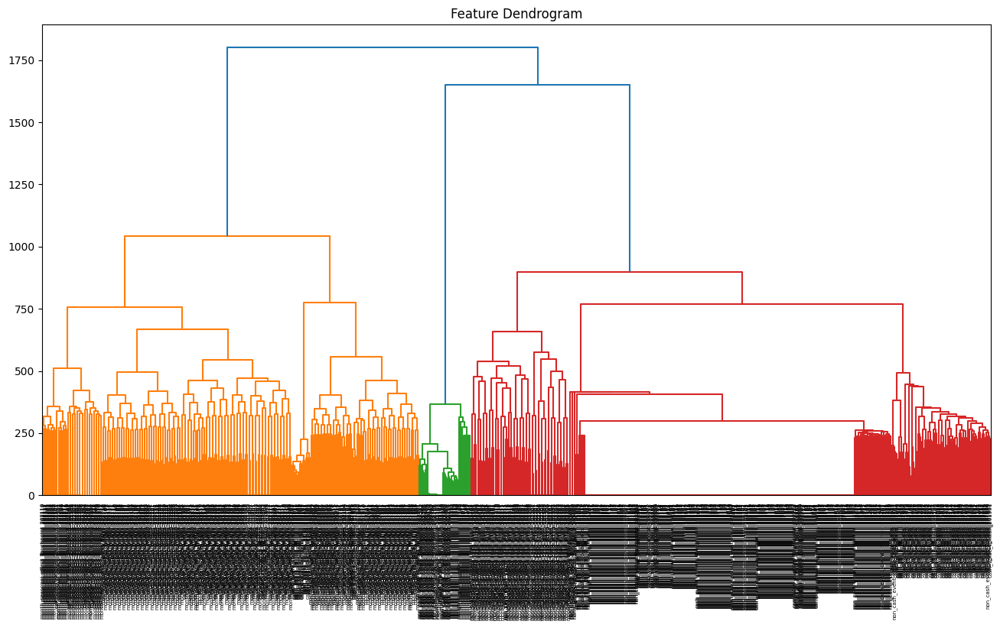

In [ ]:
# Dedograms, Linkages, and Distance Metrics
import scipy.cluster
aggl = sch.linkage(X[features].T, method='ward', metric='euclidean')

# Plot the dendrogram
plt.figure(figsize=(16, 8))
plt.grid(False)
plt.title("Feature Dendrogram")
dend = sch.dendrogram(aggl, labels=features)
plt.show()

In [ ]:

K=5
labels = scipy.cluster.hierarchy.fcluster(aggl, K, criterion="maxclust")

In [ ]:
np.set_printoptions(precision=2)
np.set_printoptions(suppress=True)

means = np.zeros((K, X.shape[1]))

for i, label in enumerate(set(labels)):
    means[i,:] = X[labels==label].mean(axis=0)
    print('\nCluster {} (n={}):'.format(label, sum(labels==label)))
    print(scaler.inverse_transform(means[i,:].reshape(1,-1)))

means

ValueError: Item wrong length 1230 instead of 29036.

In [ ]:
k_means = KMeans(n_clusters=2, random_state=42)
k_means.fit(X)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=2, random_state=42)

In [ ]:
k_means.inertia_

487487.7033672875

In [ ]:
from sklearn.metrics import silhouette_score, silhouette_samples
silhouette_score(X, k_means.labels_)

0.6576301108024264

In [ ]:


# # Creating a pivot table
# pivot_table = df.pivot_table(
#     index=['unique_month_id','hash_party_id'],
#     columns='event_type', 'month', 'year',
#     values=['non_cash_event_count', 'month_seasonal_effect', 'campaign_enabled','cash_value','cash_event_counts'],
#     aggfunc={'non_cash_event_count': 'sum', 'month_seasonal_effect': 'mean', 'campaign_enabled': 'sum','cash_value':'sum','cash_event_counts':'sum'}
# )

# # Flatten the column multi-index
# pivot_table.columns = [f'{col[0]}_{col[1]}' for col in pivot_table.columns]

# # Reset the index to make it a proper DataFrame
# pivot_table = pivot_table.reset_index()

# pivot_table.head()

SyntaxError: positional argument follows keyword argument (<ipython-input-32-4d0486045e8a>, line 7)

In [ ]:
#df_old=pd.read_excel('capstone_queens_to_share_1_advisor.xlsx')
#df_old.head()

In [ ]:
import sweetviz as sv
overall_report = sv.analyze([df_pivot, "Training Data"])
overall_report.show_html('Overall Data Patterns.html')

                                             |          | [  0%]   00:00 -> (? left)

Report Overall Data Patterns.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [ ]:
event_type= df['event_type'].unique()
print(sorted(event_type))

['Lead_acted', 'Lead_given', 'Sales', 'Touchpoint', 'Written']


In [ ]:
df.shape

(398556, 10)

In [ ]:
df.describe()

,month,year,non_cash_event_count,month_seasonal_effect,campaign_enabled,unique_month_id,cash_value,cash_event_counts
count,398556.000000,398556.000000,398556.000000,398556.000000,398556.000000,398556.000000,3.985560e+05,398556.000000
mean,6.251091,2021.403931,0.886764,1.615296,0.306155,35.098260,8.009448e+02,2.784201
std,3.492351,1.570363,5.742742,0.313306,0.460896,18.633199,8.593111e+03,4.208870
min,1.000000,2019.000000,0.000000,1.000000,0.000000,1.000000,-6.863700e+03,0.000000
25%,3.000000,2020.000000,0.000000,1.258819,0.000000,19.000000,1.283333e+01,2.000000
50%,6.000000,2022.000000,0.000000,1.707107,0.000000,37.000000,9.244000e+01,2.000000
75%,9.000000,2023.000000,0.000000,1.866025,1.000000,51.000000,2.855833e+02,4.000000
max,12.000000,2024.000000,1109.000000,2.000000,1.000000,65.000000,1.982556e+06,616.000000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 398556 entries, 0 to 398555
Data columns (total 10 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   month                  398556 non-null  int64  
 1   year                   398556 non-null  int64  
 2   event_type             398556 non-null  object 
 3   non_cash_event_count   398556 non-null  int64  
 4   month_seasonal_effect  398556 non-null  float64
 5   campaign_enabled       398556 non-null  int64  
 6   unique_month_id        398556 non-null  int64  
 7   hash_party_id          398556 non-null  object 
 8   cash_value             398556 non-null  float64
 9   cash_event_counts      398556 non-null  int64  
dtypes: float64(2), int64(6), object(2)
memory usage: 30.4+ MB


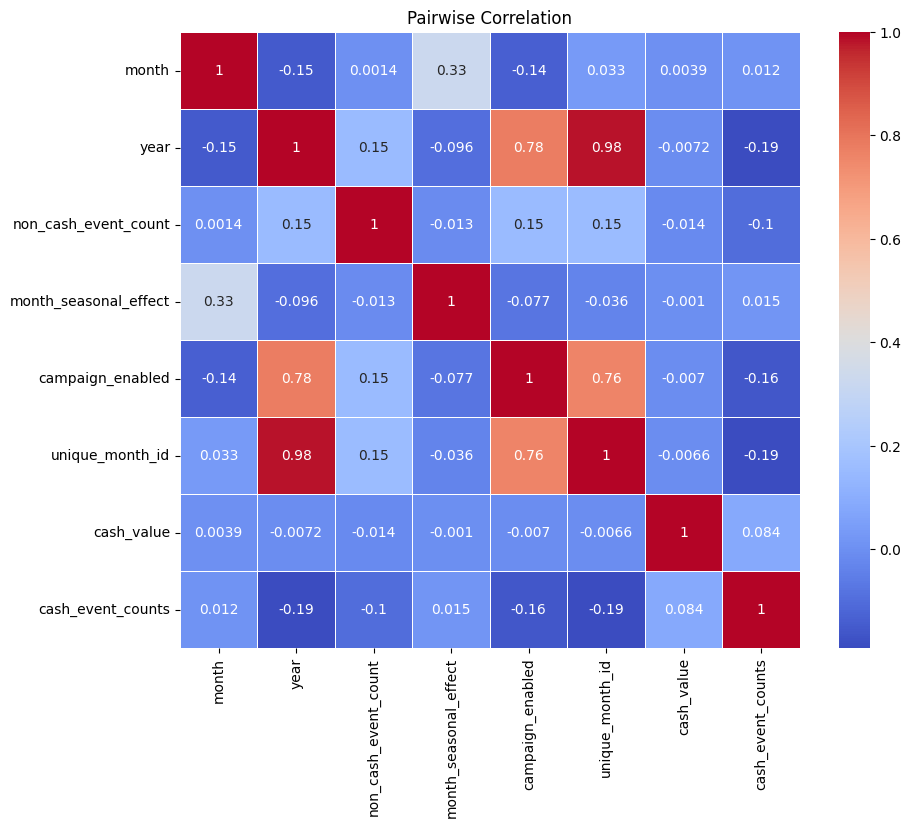

In [ ]:
# Select only the numeric columns
numeric_df = df.select_dtypes(include=[float, int])
corr_matrix = numeric_df.corr()

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Pairwise Correlation')
plt.show()

In [ ]:
# Create new columns to count the total of the one_hot_month columns
grouped_df['total_one_hot_month'] = grouped_df[one_hot_month.columns].sum(axis=1)
grouped_df['total_one_hot_year'] = grouped_df[one_hot_year.columns].sum(axis=1)
grouped_df['total_one_hot_unique_month_id'] = grouped_df[one_hot_unique_month_id.columns].sum(axis=1)
grouped_df['total_one_hot_campaign_enabled'] = grouped_df[one_hot_campaign_enabled.columns].sum(axis=1)

In [ ]:
grouped_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29068 entries, 0 to 29067
Data columns (total 99 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   hash_party_id                   29068 non-null  object 
 1   event_type_Lead_acted           29068 non-null  int64  
 2   event_type_Lead_given           29068 non-null  int64  
 3   event_type_Sales                29068 non-null  int64  
 4   event_type_Touchpoint           29068 non-null  int64  
 5   event_type_Written              29068 non-null  int64  
 6   month_1                         29068 non-null  int64  
 7   month_2                         29068 non-null  int64  
 8   month_3                         29068 non-null  int64  
 9   month_4                         29068 non-null  int64  
 10  month_5                         29068 non-null  int64  
 11  month_6                         29068 non-null  int64  
 12  month_7                         

In [ ]:
# One-hot encode the event_type, month, year, unique_month_id, and campaign_enabled columns
one_hot_event_type = pd.get_dummies(df['event_type'], prefix='event_type')
one_hot_month = pd.get_dummies(df['month'], prefix='month')
one_hot_year = pd.get_dummies(df['year'], prefix='year')
one_hot_unique_month_id = pd.get_dummies(df['unique_month_id'], prefix='unique_month_id')
one_hot_campaign_enabled = pd.get_dummies(df['campaign_enabled'], prefix='campaign_enabled')

# Add the one-hot encoded columns to the original DataFrame
df = pd.concat([df, one_hot_event_type, one_hot_month, one_hot_year, one_hot_unique_month_id, one_hot_campaign_enabled], axis=1)

# Group by hash_party_id and sum/average the values
grouped_df = df.groupby('hash_party_id').agg(
    {**{col: 'sum' for col in one_hot_event_type.columns},
     **{col: 'sum' for col in one_hot_month.columns},
     **{col: 'sum' for col in one_hot_year.columns},
     **{col: 'sum' for col in one_hot_unique_month_id.columns},
     **{col: 'sum' for col in one_hot_campaign_enabled.columns},
     'cash_value': 'sum',
     'cash_event_counts': 'sum',
     'non_cash_event_count': 'sum',
     'month_seasonal_effect': 'mean'}
).reset_index()

# Display the transformed DataFrame
grouped_df.head()

,hash_party_id,event_type_Lead_acted,event_type_Lead_given,event_type_Sales,event_type_Touchpoint,event_type_Written,month_1,month_2,month_3,month_4,...,unique_month_id_62,unique_month_id_63,unique_month_id_64,unique_month_id_65,campaign_enabled_0,campaign_enabled_1,cash_value,cash_event_counts,non_cash_event_count,month_seasonal_effect
0,000013bcbc5061234c414fd84c5cf659c50993b51d318e...,0,0,0,1,0,0,0,1,0,...,0,1,0,0,0,1,0.000000,0,2,1.500000
1,0005beeed89efc9d458ef12143612942a0a0fc1cd89131...,0,0,18,3,10,4,3,3,3,...,0,0,0,0,27,4,17790.186742,62,4,1.600989
2,000a09eac5575dd9fba6fcdba4967a8ce336a90bb15cab...,0,0,0,1,0,0,0,0,0,...,0,0,0,0,1,0,0.000000,0,1,1.866025
3,000d0a991a0e1da99b46c98fffb82797f8590a1ae93573...,0,0,16,5,17,3,4,6,3,...,0,1,0,0,36,2,15051.263186,136,14,1.624441
4,000eb3c1db47968d465bcd2c2eaa227d76d51363f9e836...,0,0,0,1,0,0,1,0,0,...,0,0,0,0,0,1,0.000000,0,4,1.258819


In [ ]:
grouped_df.head()

,hash_party_id,event_type_Lead_acted,event_type_Lead_given,event_type_Sales,event_type_Touchpoint,event_type_Written,month_1,month_2,month_3,month_4,...,unique_month_id_62,unique_month_id_63,unique_month_id_64,unique_month_id_65,campaign_enabled_0,campaign_enabled_1,cash_value,cash_event_counts,non_cash_event_count,month_seasonal_effect
0,000013bcbc5061234c414fd84c5cf659c50993b51d318e...,0,0,0,1,0,0,0,1,0,...,0,1,0,0,0,1,0.000000,0,2,1.500000
1,0005beeed89efc9d458ef12143612942a0a0fc1cd89131...,0,0,18,3,10,4,3,3,3,...,0,0,0,0,27,4,17790.186742,62,4,1.600989
2,000a09eac5575dd9fba6fcdba4967a8ce336a90bb15cab...,0,0,0,1,0,0,0,0,0,...,0,0,0,0,1,0,0.000000,0,1,1.866025
3,000d0a991a0e1da99b46c98fffb82797f8590a1ae93573...,0,0,16,5,17,3,4,6,3,...,0,1,0,0,36,2,15051.263186,136,14,1.624441
4,000eb3c1db47968d465bcd2c2eaa227d76d51363f9e836...,0,0,0,1,0,0,1,0,0,...,0,0,0,0,0,1,0.000000,0,4,1.258819


In [ ]:
grouped_df.head(5).to_csv('output.csv', index=False)

In [ ]:
# Select the specified features to keep
features = [
    # 'hash_party_id',
    'event_type_Lead_acted', 'event_type_Lead_given',
    'event_type_Sales', 'event_type_Touchpoint', 'event_type_Written',
    'campaign_enabled_0', 'campaign_enabled_1', 'cash_value',
    'cash_event_counts', 'non_cash_event_count', 'month_seasonal_effect',
    'total_one_hot_campaign_enabled'
]
filterde_df = grouped_df[features]

KeyError: "['total_one_hot_campaign_enabled'] not in index"

In [ ]:
filterde_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29068 entries, 0 to 29067
Data columns (total 13 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   hash_party_id                   29068 non-null  object 
 1   event_type_Lead_acted           29068 non-null  int64  
 2   event_type_Lead_given           29068 non-null  int64  
 3   event_type_Sales                29068 non-null  int64  
 4   event_type_Touchpoint           29068 non-null  int64  
 5   event_type_Written              29068 non-null  int64  
 6   campaign_enabled_0              29068 non-null  int64  
 7   campaign_enabled_1              29068 non-null  int64  
 8   cash_value                      29068 non-null  float64
 9   cash_event_counts               29068 non-null  int64  
 10  non_cash_event_count            29068 non-null  int64  
 11  month_seasonal_effect           29068 non-null  float64
 12  total_one_hot_campaign_enabled  

In [ ]:
# grouped_df.to_csv ('grouped_df.csv', index=False)

In [ ]:
filterde_df = grouped_df[features]

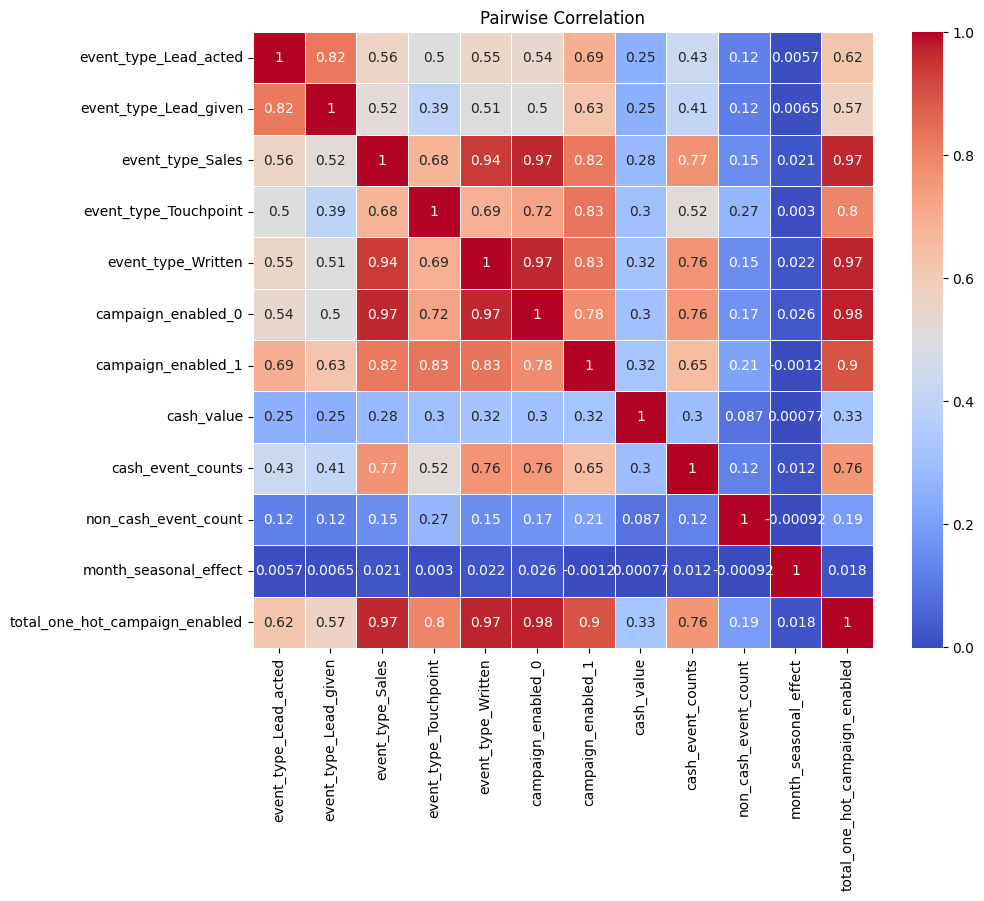

In [ ]:
# Select only the numeric columns
numeric_df = filterde_df.select_dtypes(include=[float, int])
corr_matrix = numeric_df.corr()

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Pairwise Correlation')
plt.show()

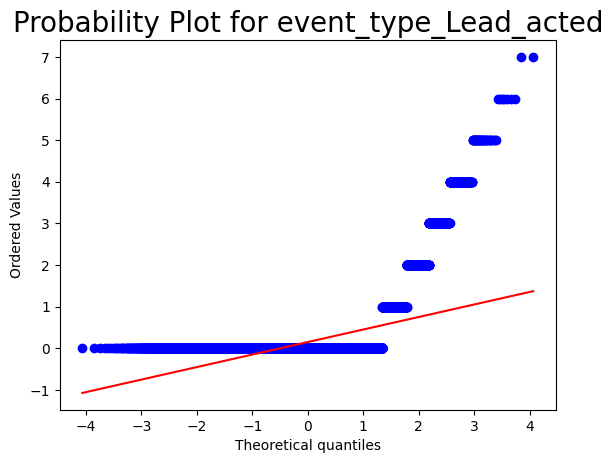

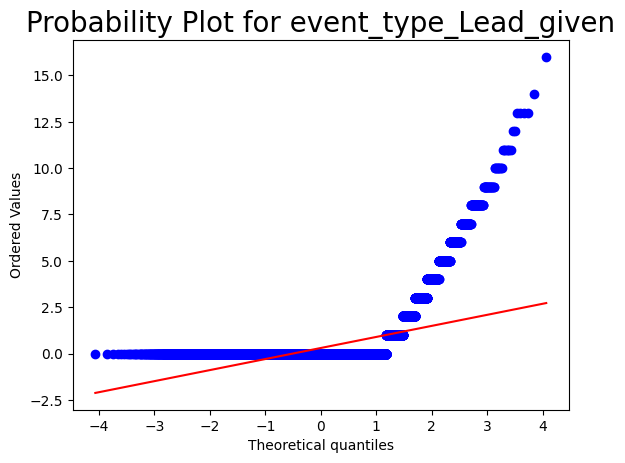

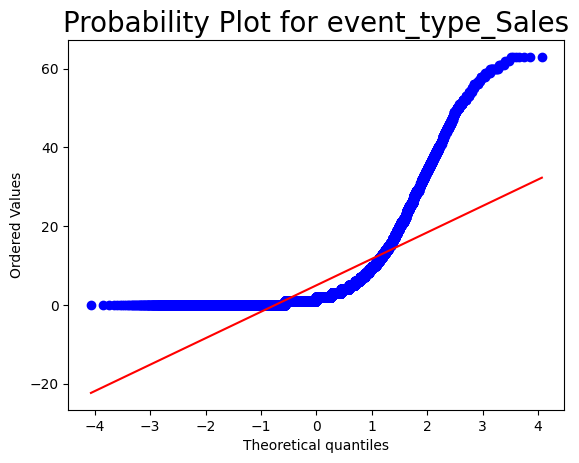

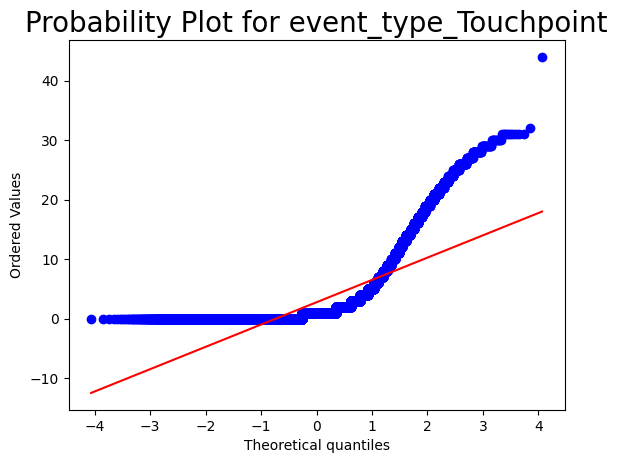

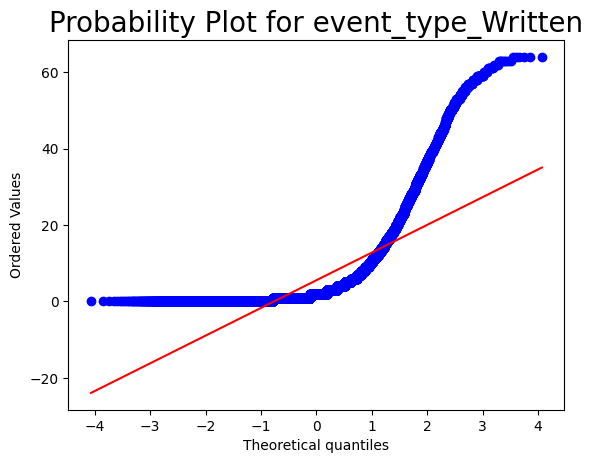

...

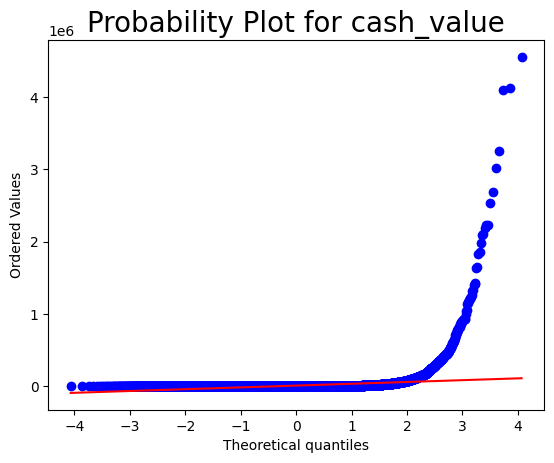

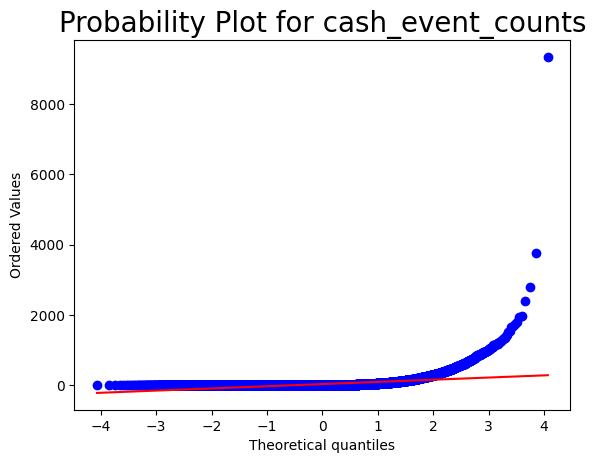

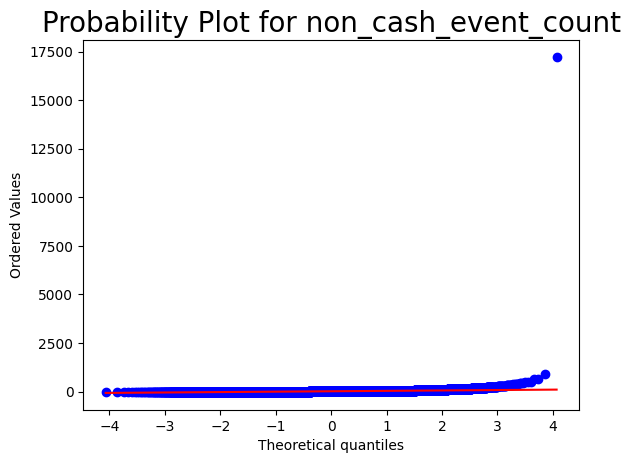

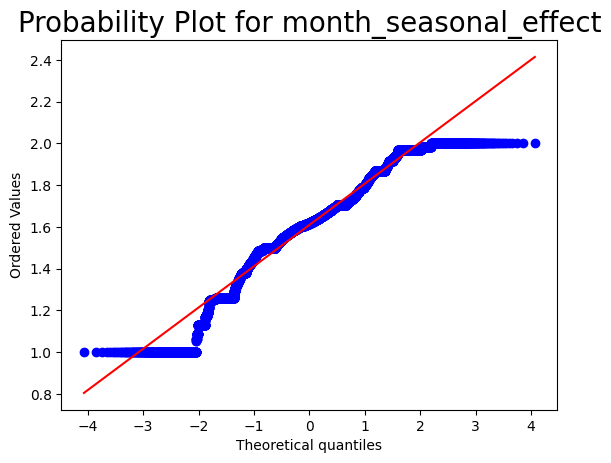

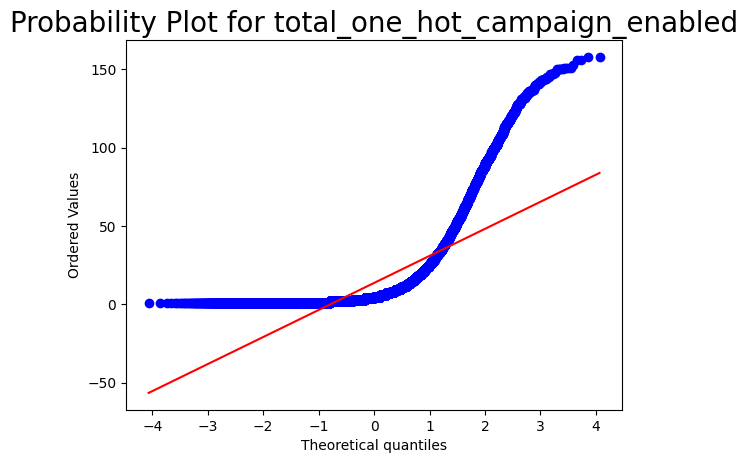

In [ ]:
#prob plot
for feature in features:
    fig = plt.figure()
    ax = fig.add_subplot(111)
    res = stats.probplot(filterde_df[feature], plot=ax)
    ax.set_title(f'Probability Plot for {feature}',fontsize=20)

In [ ]:
grouped_df.shape

(29068, 95)

In [ ]:
# grouped_df.info()

In [ ]:
grouped_df.describe()

,event_type_Lead_acted,event_type_Lead_given,event_type_Sales,event_type_Touchpoint,event_type_Written,month_1,month_2,month_3,month_4,month_5,...,unique_month_id_62,unique_month_id_63,unique_month_id_64,unique_month_id_65,campaign_enabled_0,campaign_enabled_1,cash_value,cash_event_counts,non_cash_event_count,month_seasonal_effect
count,29068.000000,29068.000000,29068.000000,29068.000000,29068.000000,29068.000000,29068.000000,29068.000000,29068.000000,29068.000000,...,29068.000000,29068.000000,29068.000000,29068.000000,29068.000000,29068.000000,2.906800e+04,29068.000000,29068.000000,29068.000000
mean,0.147963,0.299195,4.974783,2.738957,5.550261,1.209062,1.283576,1.414064,1.288668,1.107919,...,0.268096,0.276730,0.228671,0.010424,9.513417,4.197743,1.098188e+04,38.174625,12.158559,1.609376
std,0.553425,1.053509,8.675197,4.790234,9.255801,2.181093,2.269546,2.397206,2.220472,1.953976,...,0.673778,0.676637,0.575800,0.108446,15.625146,7.707665,8.349004e+04,113.937885,104.795955,0.201380
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,1.000000
25%,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,9.462750e+01,2.000000,0.000000,1.500000
50%,0.000000,0.000000,2.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,3.000000,1.000000,6.425250e+02,8.000000,2.000000,1.617911
75%,0.000000,0.000000,5.000000,3.000000,6.000000,1.000000,2.000000,2.000000,2.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,10.000000,4.000000,3.429799e+03,30.000000,9.000000,1.709806
max,7.000000,16.000000,63.000000,44.000000,64.000000,17.000000,17.000000,17.000000,17.000000,14.000000,...,5.000000,5.000000,4.000000,2.000000,111.000000,51.000000,4.550924e+06,9336.000000,17223.000000,2.000000


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


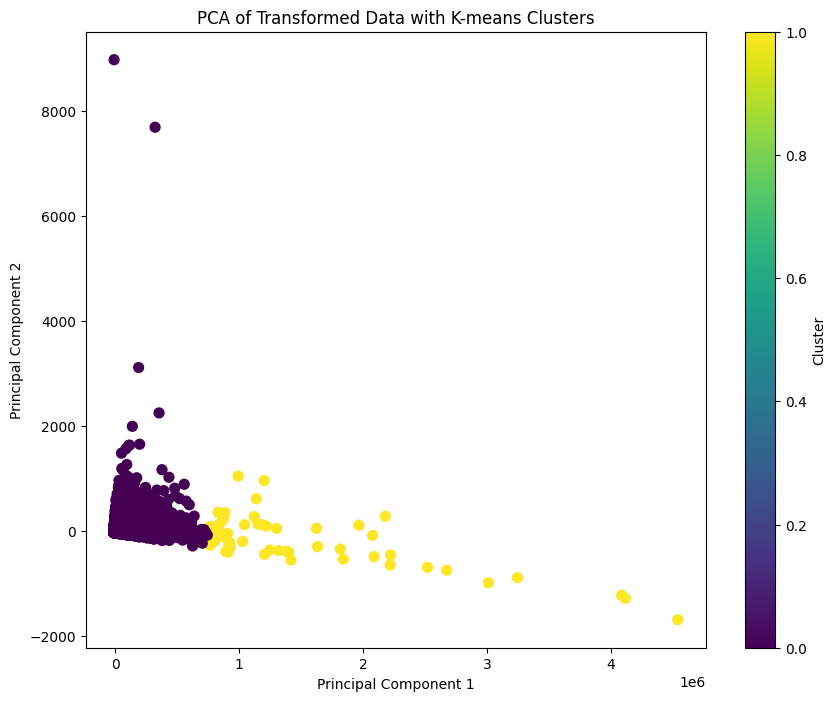

In [ ]:
# Drop the identifier column for clustering and PCA
X = grouped_df.drop('hash_party_id', axis=1)

# Apply K-means clustering
kmeans = KMeans(n_clusters=2, random_state=42)
grouped_df['cluster'] = kmeans.fit_predict(X)

# Apply PCA for dimensionality reduction
pca = PCA(n_components=2)
principal_components = pca.fit_transform(X)

# Add the principal components to the DataFrame
grouped_df['pc1'] = principal_components[:, 0]
grouped_df['pc2'] = principal_components[:, 1]

# Plot the clusters
plt.figure(figsize=(10, 8))
plt.scatter(grouped_df['pc1'], grouped_df['pc2'], c=grouped_df['cluster'], cmap='viridis', s=50)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of Transformed Data with K-means Clusters')
plt.colorbar(label='Cluster')
plt.show()


In [ ]:
# Get explained variance ratio
explained_variance = pca.explained_variance_ratio_
print(f'Explained variance ratio: {explained_variance}')

Explained variance ratio: [9.99996647e-01 1.85056024e-06]


In [ ]:
# Get the loadings (coefficients of the original features in the principal components)
loadings = pca.components_.T
pca_loadings_df = pd.DataFrame(loadings, columns=['PC1', 'PC2'], index=grouped_df.drop(['hash_party_id', 'cluster', 'pc1', 'pc2'], axis=1).columns)
print(pca_loadings_df)


                                PC1       PC2
event_type_Lead_acted  1.673533e-06  0.001791
event_type_Lead_given  3.192006e-06  0.003149
event_type_Sales       2.933405e-05  0.050720
event_type_Touchpoint  1.726470e-05  0.021055
event_type_Written     3.503304e-05  0.053194
...                             ...       ...
campaign_enabled_1     2.951663e-05  0.039430
cash_value             9.999999e-01 -0.000409
cash_event_counts      4.026080e-04  0.840452
non_cash_event_count   1.090585e-04  0.522752
month_seasonal_effect  1.868108e-09  0.000018

[94 rows x 2 columns]


In [ ]:
pca_loadings_df

,PC1,PC2
event_type_Lead_acted,1.673533e-06,0.001791
event_type_Lead_given,3.192006e-06,0.003149
event_type_Sales,2.933405e-05,0.050720
event_type_Touchpoint,1.726470e-05,0.021055
event_type_Written,3.503304e-05,0.053194
month_1,7.806132e-06,0.011711
month_2,8.289708e-06,0.012144
month_3,8.513473e-06,0.012704
month_4,7.854764e-06,0.011862
month_5,6.451597e-06,0.010292


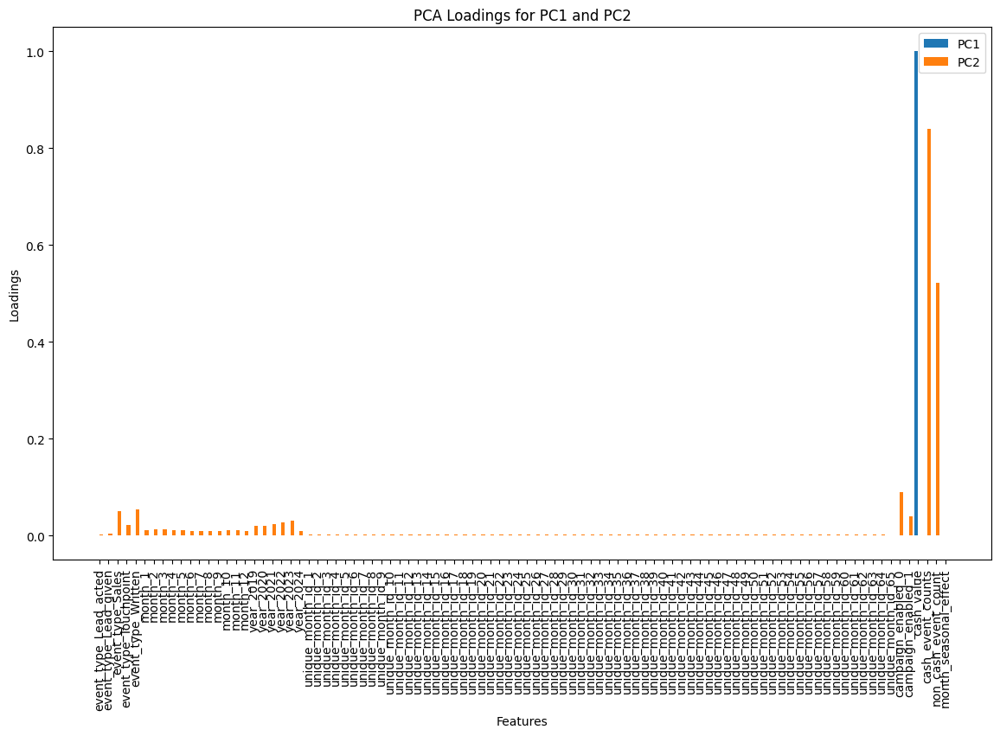

In [ ]:
# Plot the loadings for PC1 and PC2
plt.figure(figsize=(14, 8))
loadings = pca.components_.T

# Get the number of features
num_features = loadings.shape[0]

# Plot the loadings
x = np.arange(num_features)
plt.bar(x - 0.2, loadings[:, 0], width=0.4, label='PC1')
plt.bar(x + 0.2, loadings[:, 1], width=0.4, label='PC2')

# Add feature names as labels
plt.xticks(x, pca_loadings_df.index, rotation=90)
plt.xlabel('Features')
plt.ylabel('Loadings')
plt.title('PCA Loadings for PC1 and PC2')
plt.legend()
plt.show()

In [ ]:

# Fit PCA with more components
pca = PCA(n_components=5)
principal_components = pca.fit_transform(X_scaled)

# Explained variance ratio for each component
explained_variance = pca.explained_variance_ratio_
print(f'Explained variance ratio: {explained_variance}')

Explained variance ratio: [0.47451118 0.05660285 0.02478555 0.01826729 0.01668419]


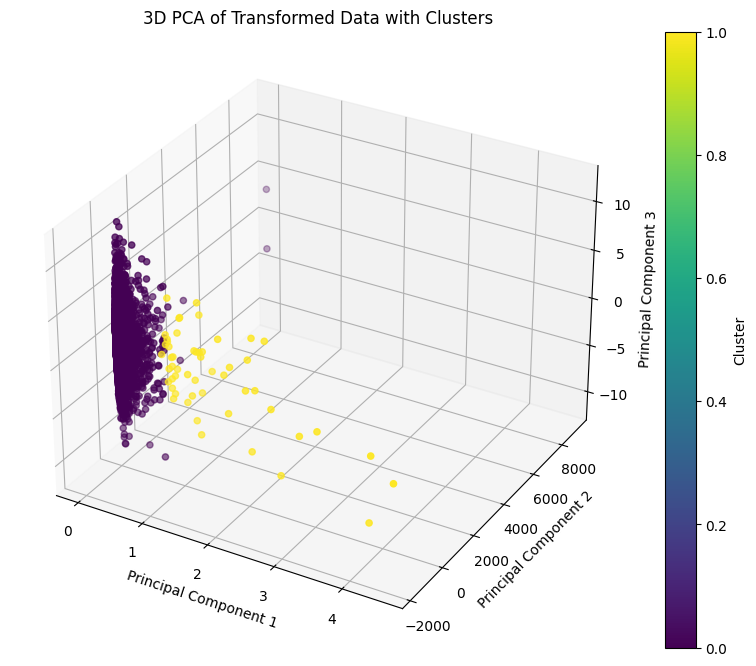

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

# Add the third principal component to the DataFrame
grouped_df['pc3'] = principal_components[:, 2]

# Plot the 3D PCA plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(grouped_df['pc1'], grouped_df['pc2'], grouped_df['pc3'], c=grouped_df['cluster'], cmap='viridis')
plt.colorbar(sc, label='Cluster')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
plt.title('3D PCA of Transformed Data with Clusters')
plt.show()

In [ ]:

# Add the principal components to the DataFrame
grouped_df['pc1'] = principal_components[:, 0]
grouped_df['pc2'] = principal_components[:, 1]
grouped_df['pc3'] = principal_components[:, 2]



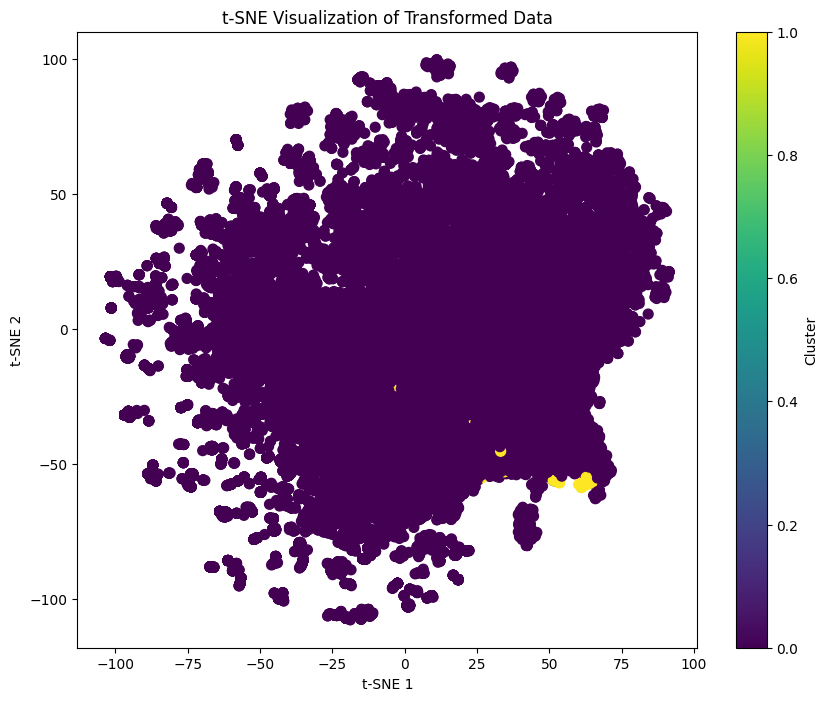

In [ ]:
from sklearn.manifold import TSNE

# Apply t-SNE
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(X_scaled)

# Add t-SNE results to the DataFrame
grouped_df['tsne_1'] = tsne_results[:, 0]
grouped_df['tsne_2'] = tsne_results[:, 1]

# Plot the t-SNE results
plt.figure(figsize=(10, 8))
plt.scatter(grouped_df['tsne_1'], grouped_df['tsne_2'], c=grouped_df['cluster'], cmap='viridis', s=50)
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.title('t-SNE Visualization of Transformed Data')
plt.colorbar(label='Cluster')
plt.show()

Explained variance ratio: [0.45929089 0.05610394 0.0340419  0.01894105 0.0177182 ]


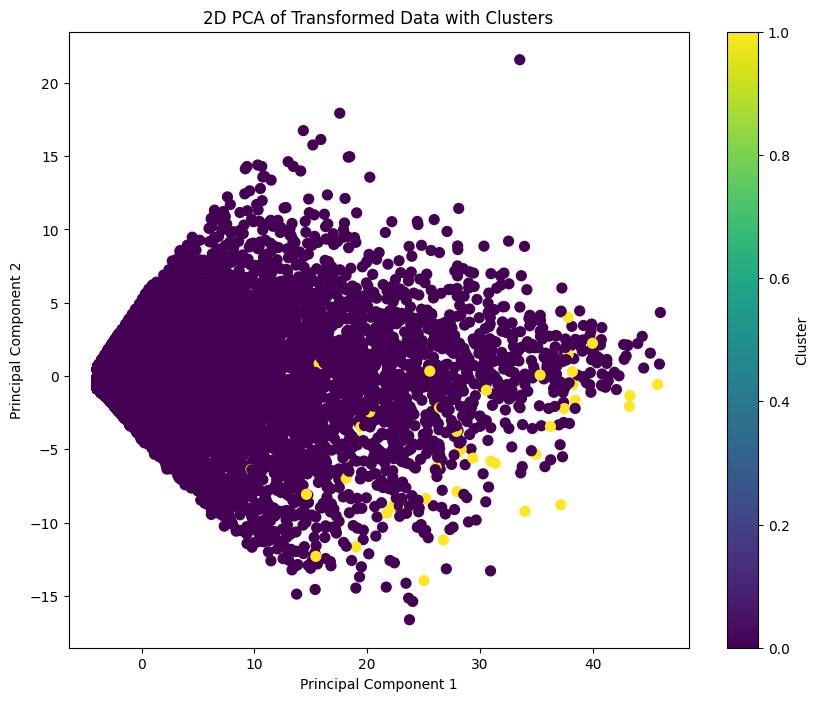

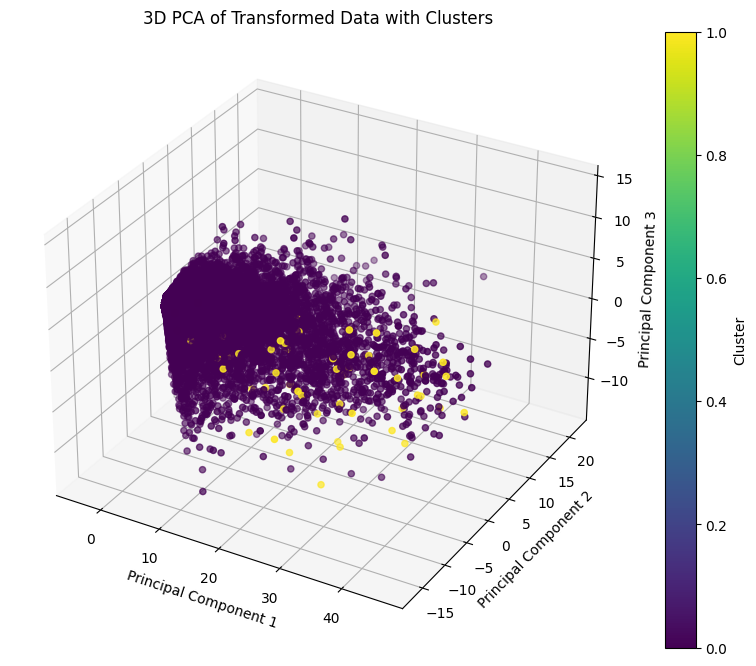

In [ ]:
# Assuming grouped_df contains the cluster labels
X = grouped_df.drop(['hash_party_id', 'cluster'], axis=1)

# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Fit PCA with 5 components
pca = PCA(n_components=5)
principal_components = pca.fit_transform(X_scaled)
explained_variance = pca.explained_variance_ratio_
print(f'Explained variance ratio: {explained_variance}')

# Add the principal components to the DataFrame
grouped_df['pc1'] = principal_components[:, 0]
grouped_df['pc2'] = principal_components[:, 1]
grouped_df['pc3'] = principal_components[:, 2]

# 2D PCA plot
plt.figure(figsize=(10, 8))
plt.scatter(grouped_df['pc1'], grouped_df['pc2'], c=grouped_df['cluster'], cmap='viridis', s=50)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('2D PCA of Transformed Data with Clusters')
plt.colorbar(label='Cluster')
plt.show()

# 3D PCA plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(grouped_df['pc1'], grouped_df['pc2'], grouped_df['pc3'], c=grouped_df['cluster'], cmap='viridis')
plt.colorbar(sc, label='Cluster')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
plt.title('3D PCA of Transformed Data with Clusters')
plt.show()

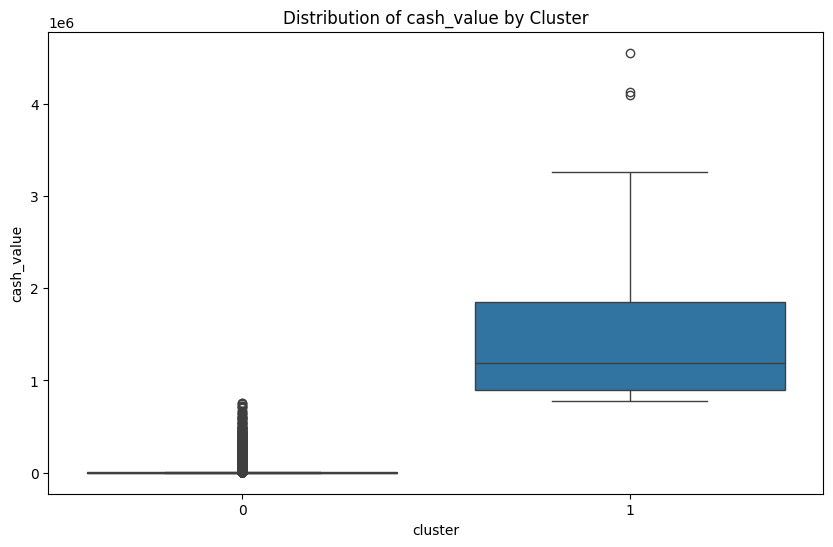

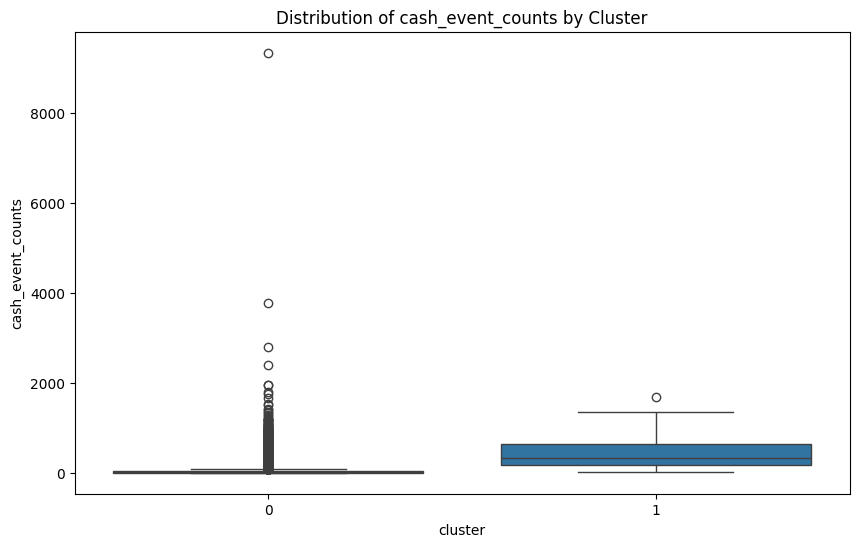

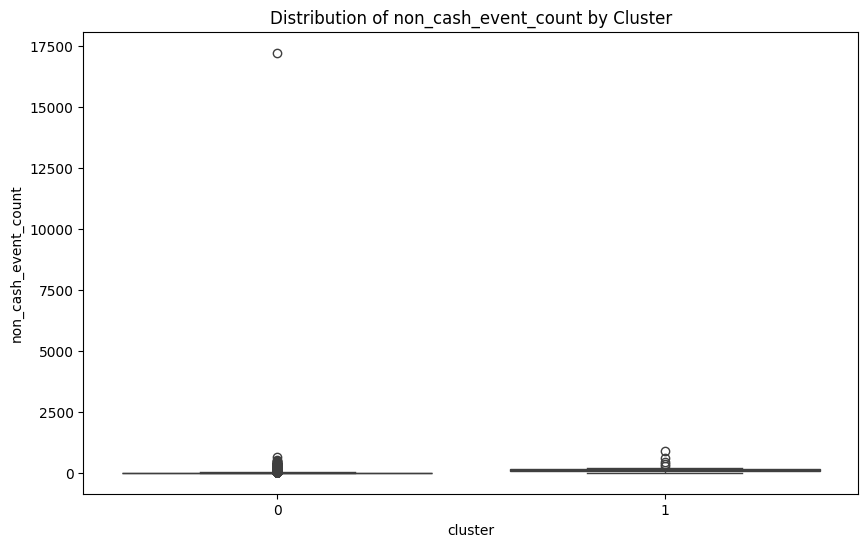

In [ ]:
# Select key features to visualize
key_features = ['cash_value', 'cash_event_counts', 'non_cash_event_count']
# Plot distributions
for feature in key_features:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='cluster', y=feature, data=grouped_df)
    plt.title(f'Distribution of {feature} by Cluster')
    plt.show()

In [ ]:
# Identify outliers in Cluster 1
outliers_cluster_1 = grouped_df[(grouped_df['cluster'] == 1) & (grouped_df['cash_value'] > grouped_df['cash_value'].quantile(0.75) + 1.5 * (grouped_df['cash_value'].quantile(0.75) - grouped_df['cash_value'].quantile(0.25)))]

print(outliers_cluster_1)

                                           hash_party_id  \
259    0210de69df27748f081b553e28bd64622beb92fbab08dd...   
379    0358448ad0272b0c77879d20cdd648eec39d8ae540c40a...   
1129   09b253643955b0653209b9021591efd0af7b93e8499830...   
1507   0cf5aa718bc87752dd848cce09bfe04b705a27c35b800f...   
2158   128c6d10d3ec3cf43fdf1f40f6c07805f356acf292d2a7...   
2497   15971b03c4d2f33813fbc1636bf56fd00c9afddb9b50ed...   
3818   2136c331dc90b9e504f55685662f17ad7e1ceafb054972...   
3999   22cfea66346074f7d35f94bbcdcddbc983cc4837baaf33...   
4748   29713492026e425c3f5d78c3619926242ac7a8361eec90...   
5091   2c4f8b520a39df47d8deabb8bfec3866cf707e8bcb90d2...   
5542   305dd576f2f8dd1cd46ccc204b97297d1c26f4ac03b932...   
6333   36e6ec4224afd52f88e46db22d01555a80b78c08315eee...   
7326   3f78ef5c41e9a3bc409db1fdd40c9ebb2b84800ebd2412...   
8375   4907d2ef36cf948ab899faadd463d2286ab7395944753c...   
8516   4a909e606db9c596982eee6383819d2e99085b7c9ebb8b...   
8603   4b597238ff905fde0763e10f1451652e3

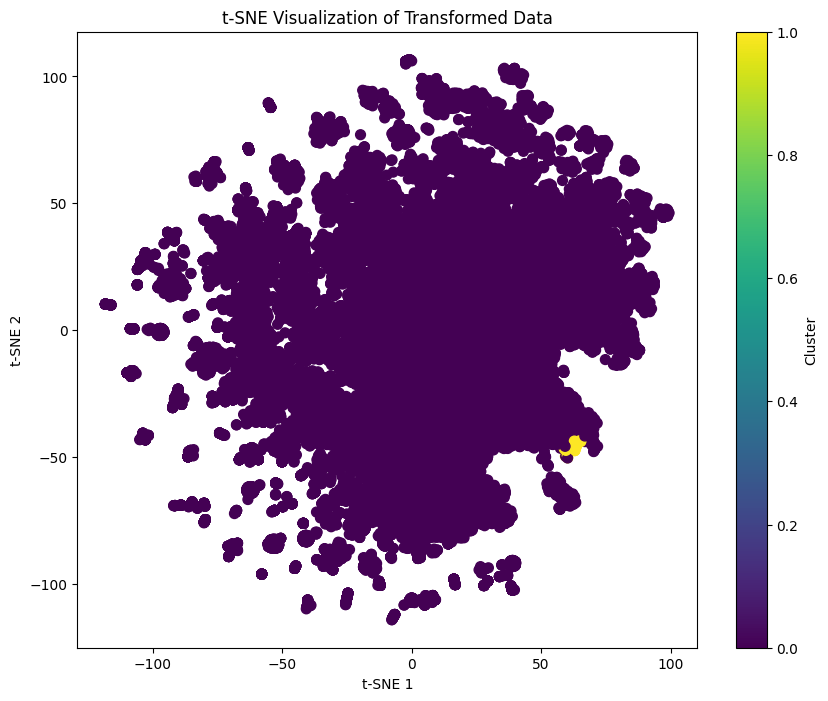

In [ ]:
from sklearn.manifold import TSNE

# Apply t-SNE
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(X_scaled)

# Add t-SNE results to the DataFrame
grouped_df['tsne_1'] = tsne_results[:, 0]
grouped_df['tsne_2'] = tsne_results[:, 1]

# Plot the t-SNE results
plt.figure(figsize=(10, 8))
plt.scatter(grouped_df['tsne_1'], grouped_df['tsne_2'], c=grouped_df['cluster'], cmap='viridis', s=50)
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.title('t-SNE Visualization of Transformed Data')
plt.colorbar(label='Cluster')
plt.show()


       event_type_Lead_acted  event_type_Lead_given  event_type_Sales  \
count              53.000000              53.000000         53.000000   
mean                1.528302               2.943396         30.924528   
std                 1.564065               3.260575         17.718796   
min                 0.000000               0.000000          0.000000   
25%                 0.000000               0.000000         17.000000   
50%                 1.000000               2.000000         29.000000   
75%                 2.000000               4.000000         45.000000   
max                 6.000000              13.000000         62.000000   

       event_type_Touchpoint  event_type_Written    month_1    month_2  \
count              53.000000           53.000000  53.000000  53.000000   
mean               19.358491           37.584906   8.188679   9.075472   
std                 8.197313           17.425042   3.828319   3.862288   
min                 0.000000            2.0000

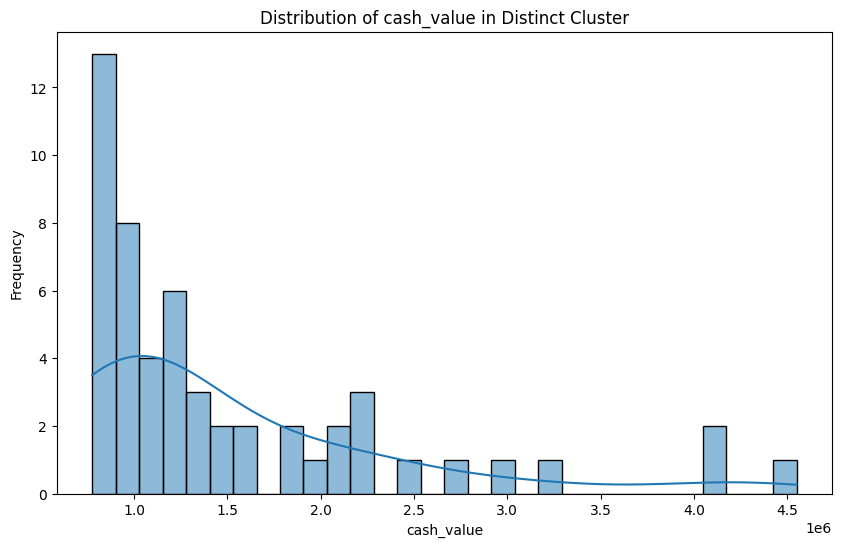

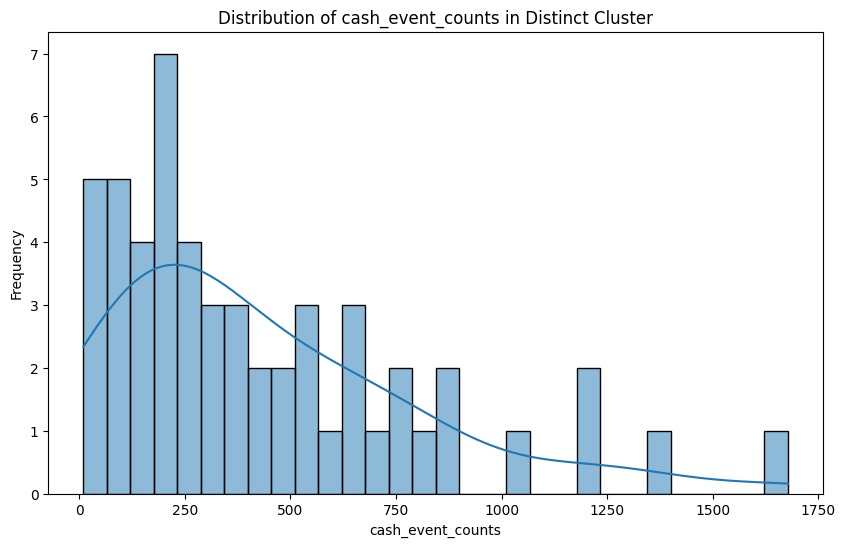

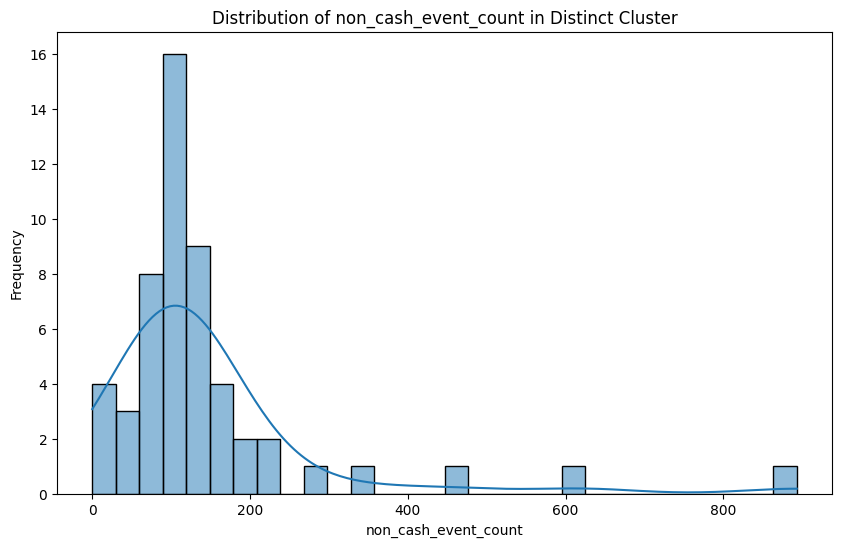

In [ ]:
# Assuming grouped_df contains the cluster labels
# Identify and examine the yellow cluster
distinct_cluster = grouped_df[grouped_df['cluster'] == 1]
print(distinct_cluster.describe())

# Plot distributions of key features for the distinct cluster
key_features = ['cash_value', 'cash_event_counts', 'non_cash_event_count']

for feature in key_features:
    plt.figure(figsize=(10, 6))
    sns.histplot(distinct_cluster[feature], bins=30, kde=True)
    plt.title(f'Distribution of {feature} in Distinct Cluster')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.show()

       event_type_Lead_acted  event_type_Lead_given  event_type_Sales  \
count           29015.000000           29015.000000      29015.000000   
mean                0.145442               0.294365          4.927382   
std                 0.546779               1.039259          8.579132   
min                 0.000000               0.000000          0.000000   
25%                 0.000000               0.000000          0.000000   
50%                 0.000000               0.000000          2.000000   
75%                 0.000000               0.000000          5.000000   
max                 7.000000              16.000000         63.000000   

       event_type_Touchpoint  event_type_Written       month_1       month_2  \
count           29015.000000        29015.000000  29015.000000  29015.000000   
mean                2.708599            5.491746      1.196312      1.269343   
std                 4.728885            9.132587      2.156487      2.241072   
min                 0.

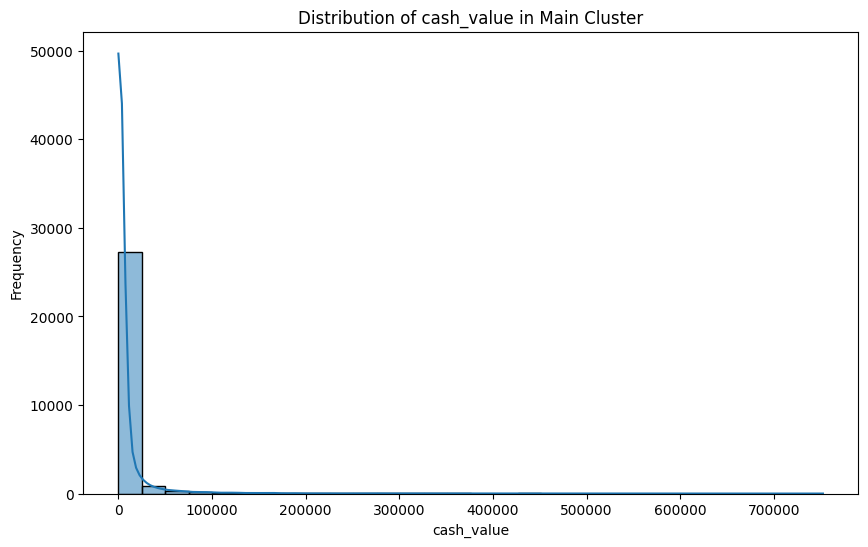

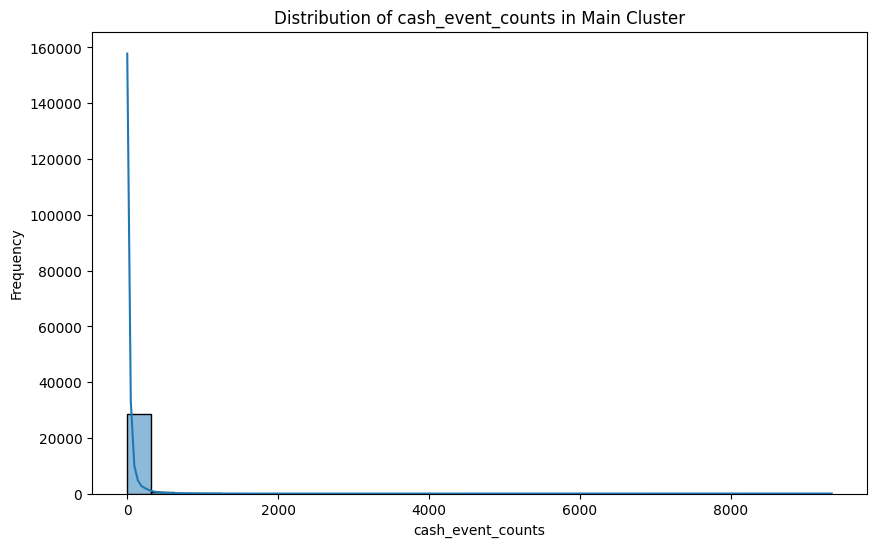

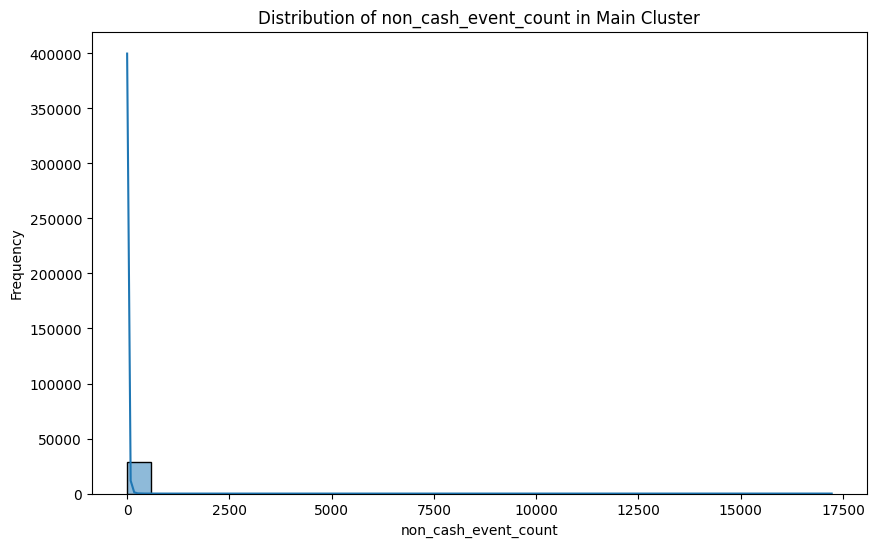

In [ ]:
# Profile the main (purple) cluster
main_cluster = grouped_df[grouped_df['cluster'] == 0]
print(main_cluster.describe())

# Plot distributions of key features for the main cluster
for feature in key_features:
    plt.figure(figsize=(10, 6))
    sns.histplot(main_cluster[feature], bins=30, kde=True)
    plt.title(f'Distribution of {feature} in Main Cluster')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.show()

In [ ]:
# Further investigate outliers
outliers_distinct = distinct_cluster[(distinct_cluster['cash_value'] > 4000000) | (distinct_cluster['cash_event_counts'] > 1000) | (distinct_cluster['non_cash_event_count'] > 800)]
print(outliers_distinct)

# Summarize key statistics for each cluster
summary_distinct = distinct_cluster.describe()
summary_main = main_cluster.describe()

print("Summary Statistics for Distinct Cluster:\n", summary_distinct)
print("Summary Statistics for Main Cluster:\n", summary_main)

# Correlation analysis within each cluster
correlation_distinct = distinct_cluster.corr()
correlation_main = main_cluster.corr()

print("Correlation Matrix for Distinct Cluster:\n", correlation_distinct)
print("Correlation Matrix for Main Cluster:\n", correlation_main)


                                           hash_party_id  \
379    0358448ad0272b0c77879d20cdd648eec39d8ae540c40a...   
5542   305dd576f2f8dd1cd46ccc204b97297d1c26f4ac03b932...   
8663   4be78618173981372858cd1aa26be0df97c0c817f0d23a...   
12036  692b6270b1bb6f59ae0410dac2a3215295ff8e01ff46e4...   
16797  92be447cc0e2b7a97e6dd45f60cc9865a75e91a676e010...   
21719  bec6e6d52102a572b8a818d3efb94e777ff352ecb03b22...   
25177  dce739d5fa09b719d12968a7f9696f90fbb031bbdecacf...   
25622  e1081d4c9b10f29b1fff0729191d6d30251b03d20bd523...   

       event_type_Lead_acted  event_type_Lead_given  event_type_Sales  \
379                        0                      0                61   
5542                       1                      1                49   
8663                       4                     13                25   
12036                      0                      0                57   
16797                      0                      6                17   
21719                

ValueError: could not convert string to float: '0210de69df27748f081b553e28bd64622beb92fbab08dd3f58412668a00bfc90'

,hash_party_id,event_type_Lead_acted,event_type_Lead_given,event_type_Sales,event_type_Touchpoint,event_type_Written,month_1,month_2,month_3,month_4,...,cash_value,cash_event_counts,non_cash_event_count,month_seasonal_effect,cluster,pc1,pc2,pc3,tsne_1,tsne_2
379,0358448ad0272b0c77879d20cdd648eec39d8ae540c40a...,0,0,61,28,62,14,15,15,13,...,1.976240e+06,1012,150,1.609500,1,43.309403,-1.333232,1.576299,63.468525,-46.011482
5542,305dd576f2f8dd1cd46ccc204b97297d1c26f4ac03b932...,1,1,49,22,57,9,15,12,11,...,2.189668e+06,1356,93,1.624147,1,38.451822,-1.651322,3.923444,63.367367,-46.173782
8663,4be78618173981372858cd1aa26be0df97c0c817f0d23a...,4,13,25,7,42,7,9,11,9,...,4.098094e+06,494,113,1.620374,1,27.971147,-7.888532,-11.809394,62.978821,-47.499596
12036,692b6270b1bb6f59ae0410dac2a3215295ff8e01ff46e4...,0,0,57,31,62,14,15,13,12,...,1.001458e+06,1188,893,1.610169,1,43.271139,-2.062849,3.609413,66.545738,-43.649246
16797,92be447cc0e2b7a97e6dd45f60cc9865a75e91a676e010...,0,6,17,21,20,6,5,7,4,...,4.550924e+06,130,167,1.626087,1,19.031350,-11.650566,-5.449418,62.969635,-47.551926
21719,bec6e6d52102a572b8a818d3efb94e777ff352ecb03b22...,3,8,24,22,26,8,7,10,8,...,4.127761e+06,228,456,1.561079,1,25.042932,-13.944433,-3.714732,62.972584,-47.508331
25177,dce739d5fa09b719d12968a7f9696f90fbb031bbdecacf...,2,2,62,28,62,17,15,14,15,...,1.211557e+06,1678,104,1.599831,1,45.771352,-0.565652,-2.641003,65.338715,-43.972397
25622,e1081d4c9b10f29b1fff0729191d6d30251b03d20bd523...,4,11,56,10,55,12,14,12,16,...,1.147867e+06,1230,120,1.613929,1,39.992690,2.236266,-4.818996,64.936539,-43.995468


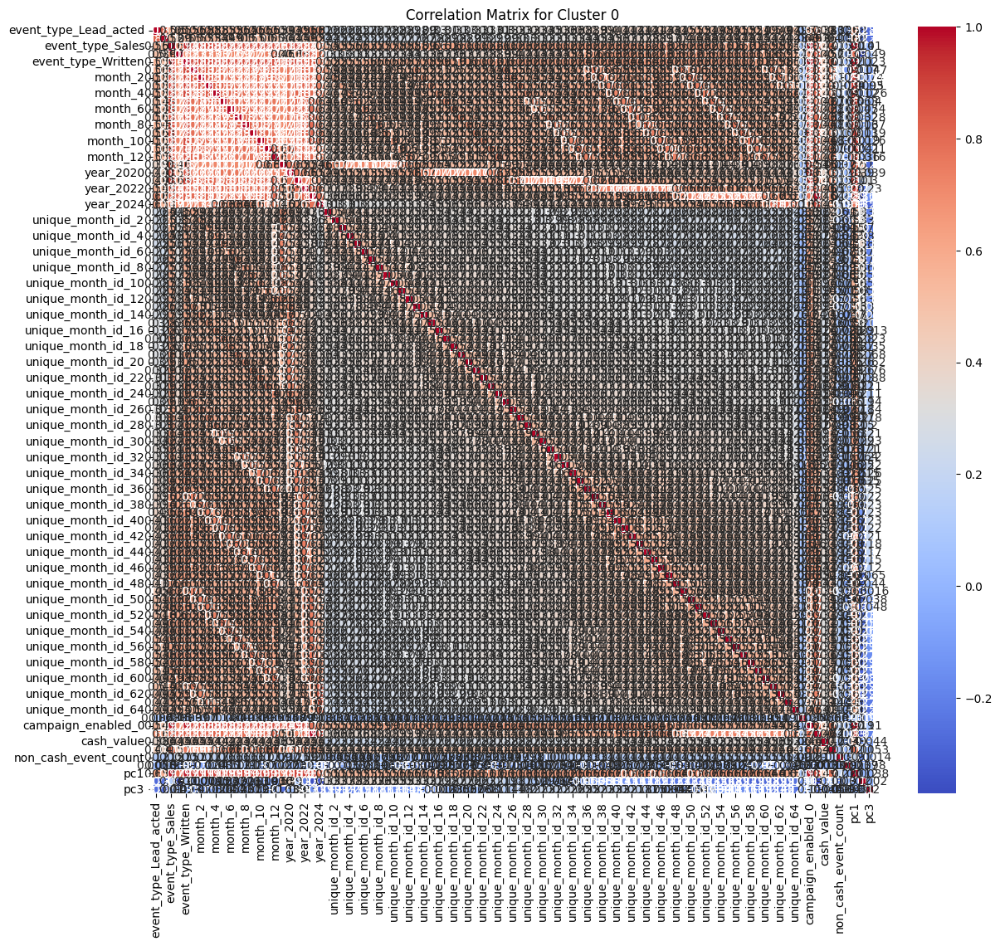

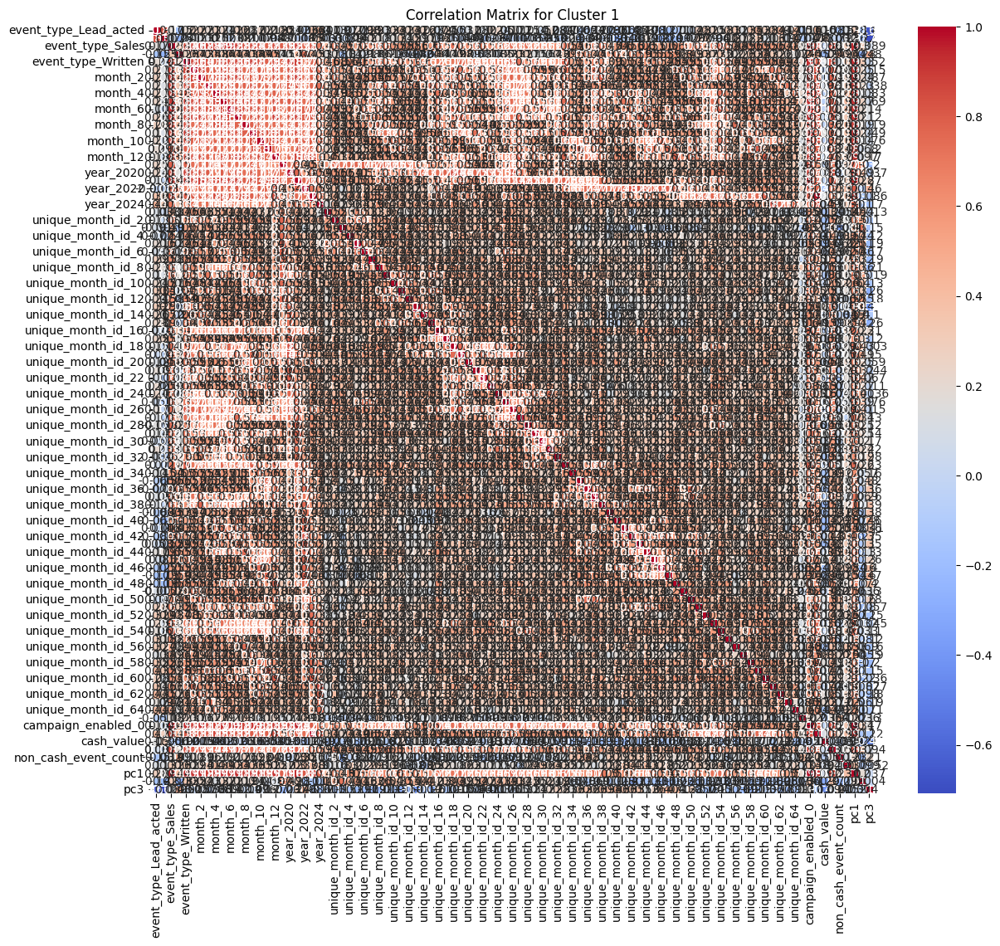

In [ ]:
# Assuming grouped_df contains the cluster labels and is already defined
# Split the dataset into separate DataFrames for each cluster
cluster_0 = grouped_df[grouped_df['cluster'] == 0]
cluster_1 = grouped_df[grouped_df['cluster'] == 1]

# Drop the non-numeric columns and the cluster label for correlation analysis
numeric_cols = [col for col in grouped_df.columns if grouped_df[col].dtype in ['int64', 'float64']]
cluster_0_numeric = cluster_0[numeric_cols]
cluster_1_numeric = cluster_1[numeric_cols]

# Compute the correlation matrices
correlation_matrix_cluster_0 = cluster_0_numeric.corr()
correlation_matrix_cluster_1 = cluster_1_numeric.corr()

# Visualize the correlation matrix for Cluster 0
plt.figure(figsize=(14, 12))
sns.heatmap(correlation_matrix_cluster_0, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix for Cluster 0')
plt.show()

# Visualize the correlation matrix for Cluster 1
plt.figure(figsize=(14, 12))
sns.heatmap(correlation_matrix_cluster_1, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix for Cluster 1')
plt.show()

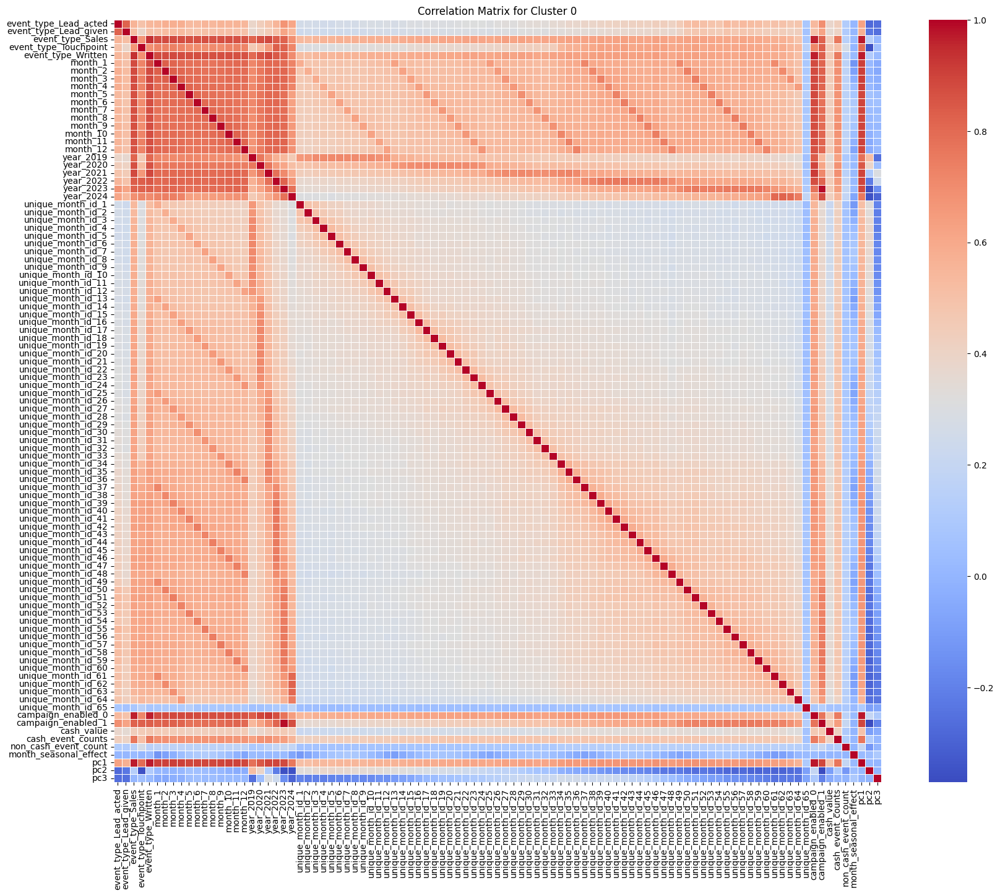

In [ ]:

# Assuming correlation_matrix_cluster_0 is already defined

# Increase figure size for better readability
plt.figure(figsize=(20, 16))

# Create a heatmap with rotated labels
sns.heatmap(correlation_matrix_cluster_0, annot=False, cmap='coolwarm', linewidths=0.5,
            xticklabels=True, yticklabels=True)

# Rotate x and y labels for better readability
plt.xticks(rotation=90)
plt.yticks(rotation=0)

# Title and display
plt.title('Correlation Matrix for Cluster 0')
plt.show()


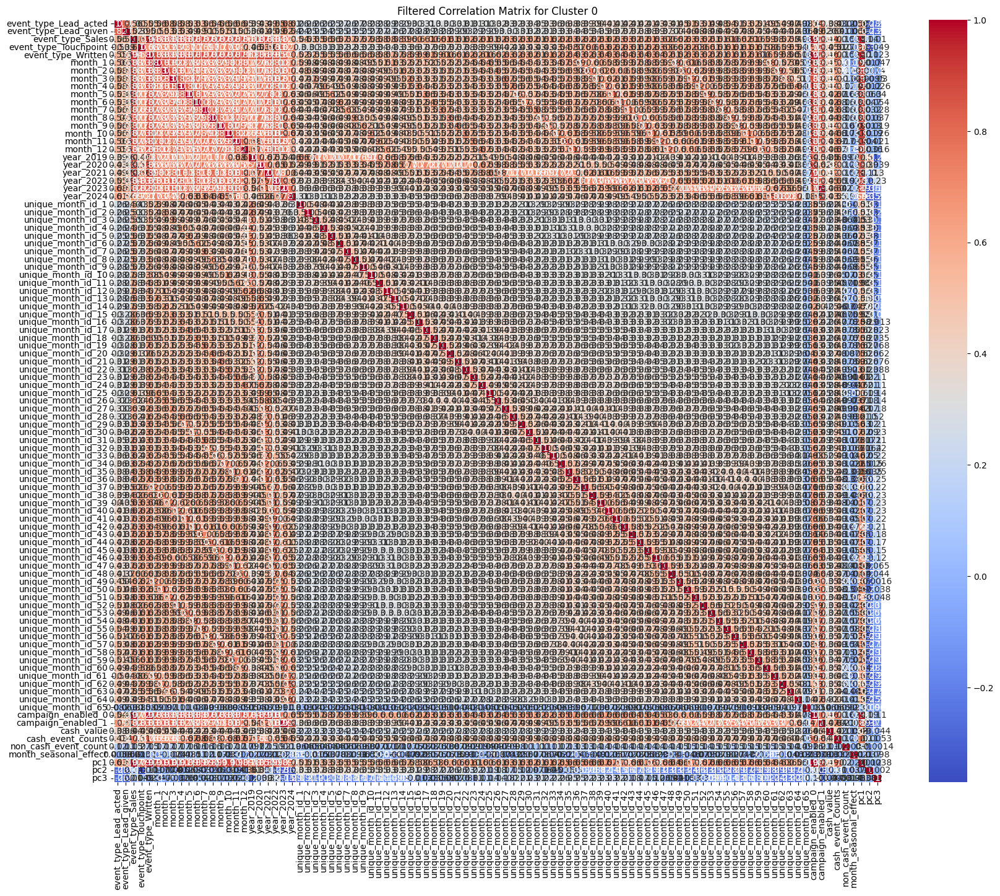

In [ ]:
# Function to filter the most relevant features based on correlation threshold
def filter_correlated_features(corr_matrix, threshold=0.5):
    relevant_features = corr_matrix.columns[(corr_matrix.abs() > threshold).any()].tolist()
    return corr_matrix.loc[relevant_features, relevant_features]

# Filter features with correlation higher than 0.5
filtered_corr_matrix_cluster_0 = filter_correlated_features(correlation_matrix_cluster_0, threshold=0.5)

# Plot the filtered heatmap
plt.figure(figsize=(20, 16))
sns.heatmap(filtered_corr_matrix_cluster_0, annot=True, cmap='coolwarm', linewidths=0.5,
            xticklabels=True, yticklabels=True)
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.title('Filtered Correlation Matrix for Cluster 0')
plt.show()


In [ ]:
grouped_df.head()

,hash_party_id,event_type_Lead_acted,event_type_Lead_given,event_type_Sales,event_type_Touchpoint,event_type_Written,month_1,month_2,month_3,month_4,...,unique_month_id_62,unique_month_id_63,unique_month_id_64,unique_month_id_65,campaign_enabled_0,campaign_enabled_1,cash_value,cash_event_counts,non_cash_event_count,month_seasonal_effect
0,000013bcbc5061234c414fd84c5cf659c50993b51d318e...,0,0,0,1,0,0,0,1,0,...,0,1,0,0,0,1,0.000000,0,2,1.500000
1,0005beeed89efc9d458ef12143612942a0a0fc1cd89131...,0,0,18,3,10,4,3,3,3,...,0,0,0,0,27,4,17790.186742,62,4,1.600989
2,000a09eac5575dd9fba6fcdba4967a8ce336a90bb15cab...,0,0,0,1,0,0,0,0,0,...,0,0,0,0,1,0,0.000000,0,1,1.866025
3,000d0a991a0e1da99b46c98fffb82797f8590a1ae93573...,0,0,16,5,17,3,4,6,3,...,0,1,0,0,36,2,15051.263186,136,14,1.624441
4,000eb3c1db47968d465bcd2c2eaa227d76d51363f9e836...,0,0,0,1,0,0,1,0,0,...,0,0,0,0,0,1,0.000000,0,4,1.258819


In [ ]:
# Calculate the mean values for each cluster
cluster_summary = grouped_df.drop('hash_party_id', axis=1).groupby('cluster').mean()

# Display the cluster summary
cluster_summary

,event_type_Lead_acted,event_type_Lead_given,event_type_Sales,event_type_Touchpoint,event_type_Written,month_1,month_2,month_3,month_4,month_5,...,unique_month_id_64,unique_month_id_65,campaign_enabled_0,campaign_enabled_1,cash_value,cash_event_counts,non_cash_event_count,month_seasonal_effect,pc1,pc2
cluster,,,,,,,,,,,,,,,,,,,,,
0,0.145442,0.294365,4.927382,2.708599,5.491746,1.196312,1.269343,1.400276,1.275271,1.097363,...,0.225745,0.010305,9.419438,4.148096,8.216574e+03,37.448354,11.918215,1.609388,-2.765308e+03,0.371995
1,1.528302,2.943396,30.924528,19.358491,37.584906,8.188679,9.075472,8.962264,8.622642,6.886792,...,1.830189,0.075472,60.962264,31.377358,1.524858e+06,435.773585,143.735849,1.602972,1.513876e+06,-203.649931


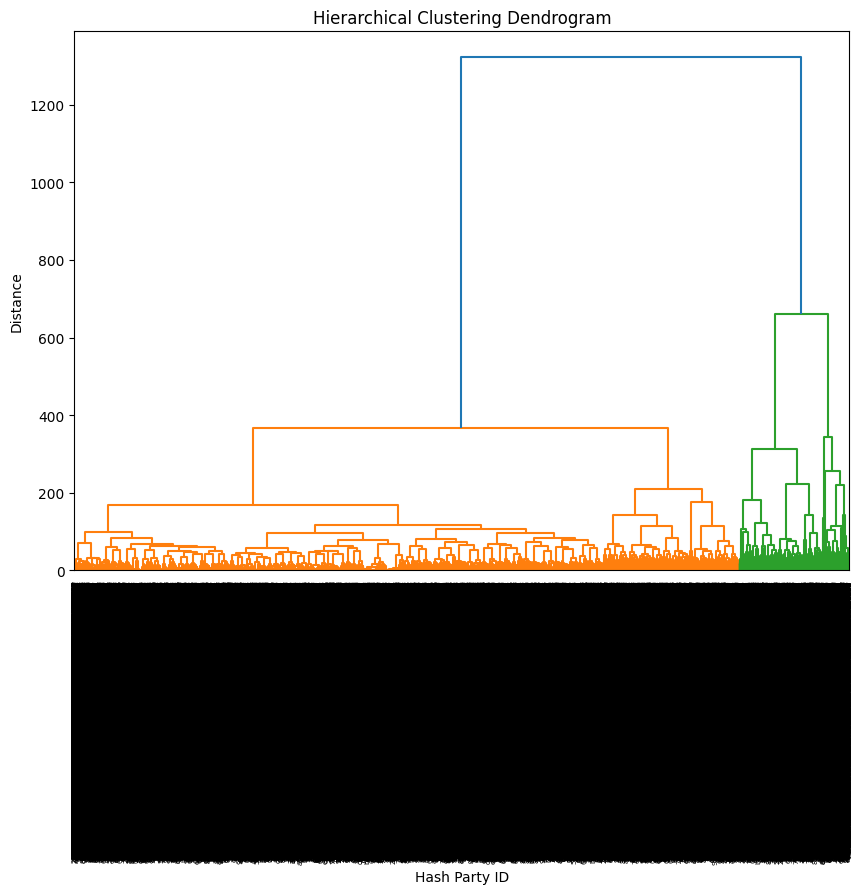

In [ ]:
# Drop the identifier column for clustering
X = grouped_df.drop('hash_party_id', axis=1)

# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Perform hierarchical clustering
linked = linkage(X_scaled, method='ward')

# Plot the dendrogram
plt.figure(figsize=(10, 7))
dendrogram(linked, labels=grouped_df['hash_party_id'].values, distance_sort='ascending', show_leaf_counts=True)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Hash Party ID')
plt.ylabel('Distance')
plt.show()

# Apply Agglomerative Clustering
agg_clustering = AgglomerativeClustering(n_clusters=2)
grouped_df['cluster'] = agg_clustering.fit_predict(X_scaled)

# # Display the transformed DataFrame with clusters
# print(grouped_df)

In [ ]:
grouped_df.head()

,hash_party_id,event_type_Lead_acted,event_type_Lead_given,event_type_Sales,event_type_Touchpoint,event_type_Written,month_1,month_2,month_3,month_4,...,unique_month_id_65,campaign_enabled_0,campaign_enabled_1,cash_value,cash_event_counts,non_cash_event_count,month_seasonal_effect,cluster,pc1,pc2
0,000013bcbc5061234c414fd84c5cf659c50993b51d318e...,0,0,0,1,0,0,0,1,0,...,0,0,1,0.000000,0,2,1.500000,1,-10981.898657,-34.956695
1,0005beeed89efc9d458ef12143612942a0a0fc1cd89131...,0,0,18,3,10,4,3,3,3,...,0,27,4,17790.186742,62,4,1.600989,0,6808.314846,16.035439
2,000a09eac5575dd9fba6fcdba4967a8ce336a90bb15cab...,0,0,0,1,0,0,0,0,0,...,0,1,0,0.000000,0,1,1.866025,1,-10981.898729,-35.412633
3,000d0a991a0e1da99b46c98fffb82797f8590a1ae93573...,0,0,16,5,17,3,4,6,3,...,0,36,2,15051.263186,136,14,1.624441,0,4069.423268,85.870773
4,000eb3c1db47968d465bcd2c2eaa227d76d51363f9e836...,0,0,0,1,0,0,1,0,0,...,0,0,1,0.000000,0,4,1.258819,1,-10981.898425,-33.890475


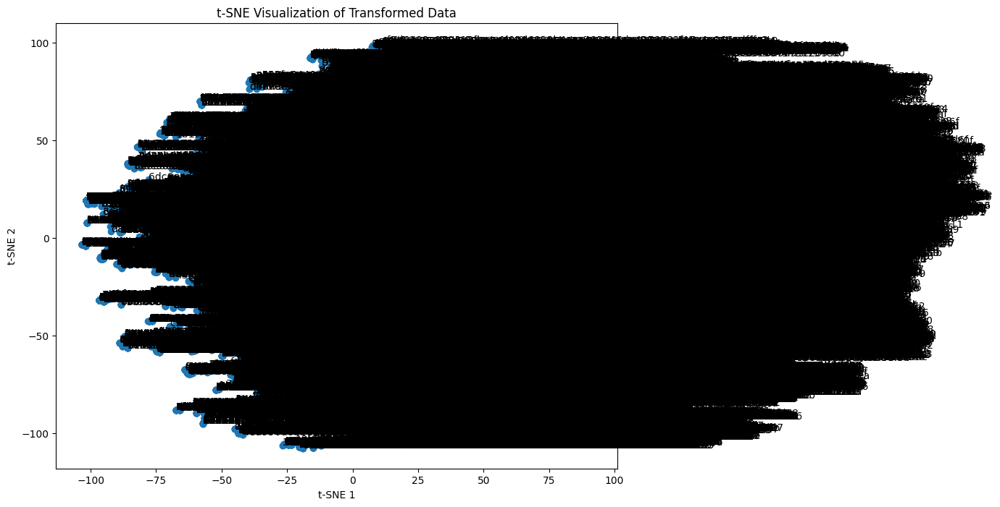

In [ ]:
# Drop the identifier column for t-SNE
X = grouped_df.drop('hash_party_id', axis=1)

# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Apply t-SNE
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(X_scaled)

# Add t-SNE results to the DataFrame
grouped_df['tsne_1'] = tsne_results[:, 0]
grouped_df['tsne_2'] = tsne_results[:, 1]

# Plot the t-SNE results
plt.figure(figsize=(10, 8))
plt.scatter(grouped_df['tsne_1'], grouped_df['tsne_2'])
for i, txt in enumerate(grouped_df['hash_party_id']):
    plt.annotate(txt, (grouped_df['tsne_1'][i], grouped_df['tsne_2'][i]))
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.title('t-SNE Visualization of Transformed Data')
plt.show()



In [ ]:
grouped_df.head()

,hash_party_id,event_type_Lead_acted,event_type_Lead_given,event_type_Sales,event_type_Touchpoint,event_type_Written,month_1,month_2,month_3,month_4,...,unique_month_id_64,unique_month_id_65,campaign_enabled_0,campaign_enabled_1,cash_value,cash_event_counts,non_cash_event_count,month_seasonal_effect,tsne_1,tsne_2
0,000013bcbc5061234c414fd84c5cf659c50993b51d318e...,0,0,0,1,0,0,0,1,0,...,0,0,0,1,0.000000,0,2,1.500000,-95.064362,-31.349146
1,0005beeed89efc9d458ef12143612942a0a0fc1cd89131...,0,0,18,3,10,4,3,3,3,...,0,0,27,4,17790.186742,62,4,1.600989,60.641102,-6.360717
2,000a09eac5575dd9fba6fcdba4967a8ce336a90bb15cab...,0,0,0,1,0,0,0,0,0,...,0,0,1,0,0.000000,0,1,1.866025,-81.271507,36.882645
3,000d0a991a0e1da99b46c98fffb82797f8590a1ae93573...,0,0,16,5,17,3,4,6,3,...,0,0,36,2,15051.263186,136,14,1.624441,55.680569,-17.697182
4,000eb3c1db47968d465bcd2c2eaa227d76d51363f9e836...,0,0,0,1,0,0,1,0,0,...,0,0,0,1,0.000000,0,4,1.258819,-63.429485,-49.853569


In [ ]:
missing_values = df.isnull().sum()
print(missing_values)


month                    0
year                     0
event_type               0
non_cash_event_count     0
month_seasonal_effect    0
campaign_enabled         0
unique_month_id          0
hash_party_id            0
cash_value               0
cash_event_counts        0
dtype: int64


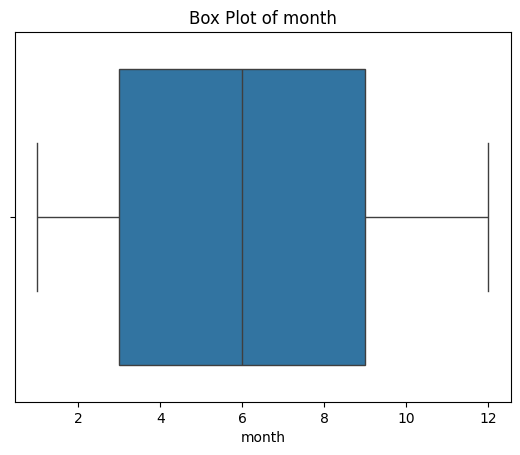

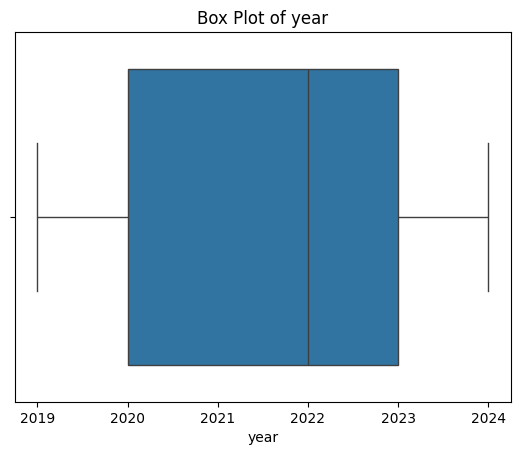

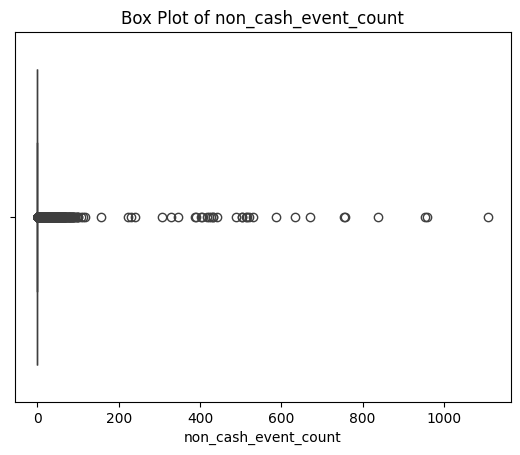

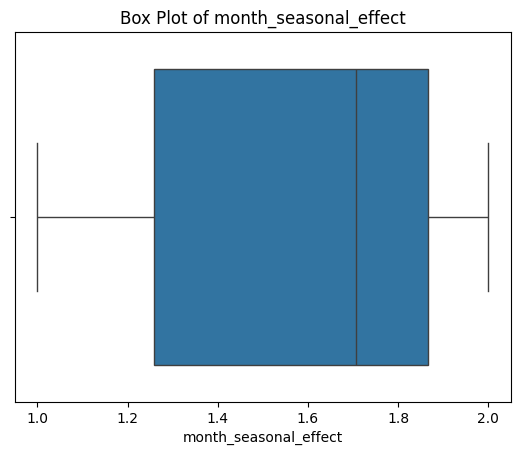

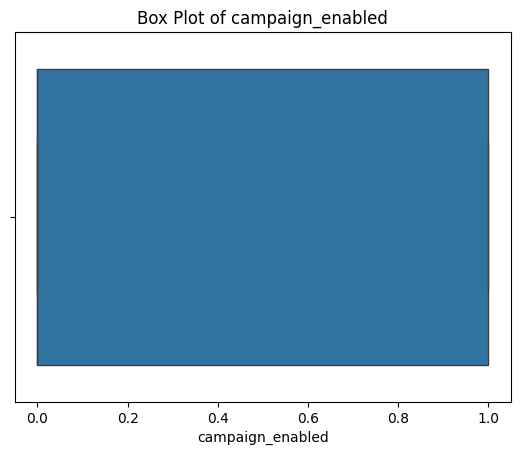

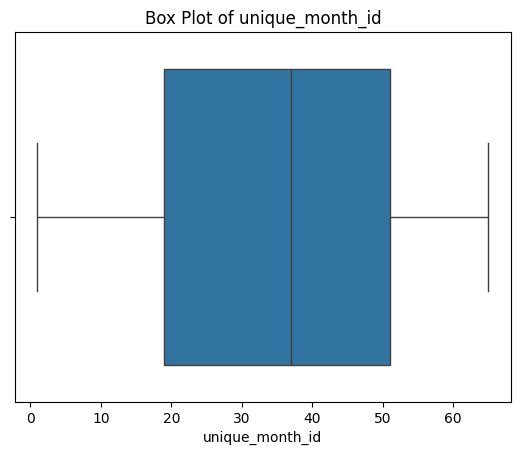

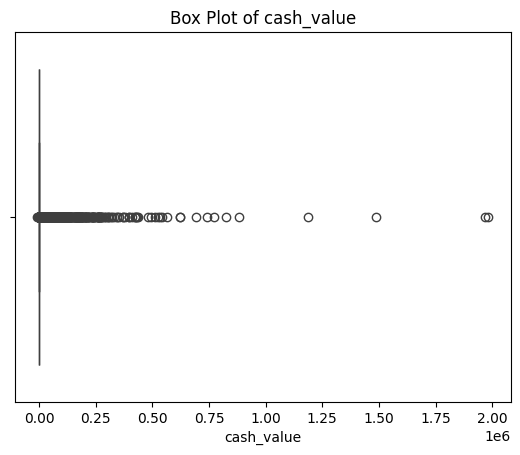

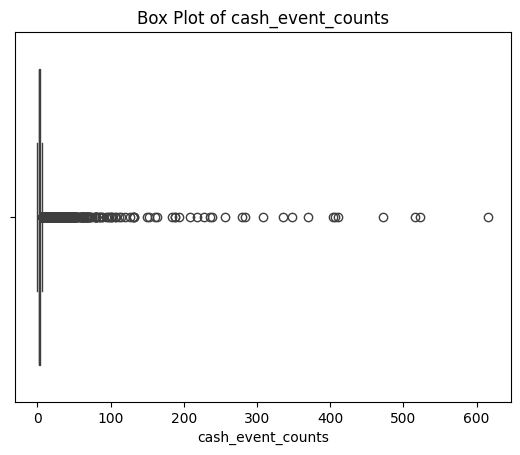

In [ ]:
for column in df.select_dtypes(include=['float64', 'int64']).columns:
    sns.boxplot(x=df[column])
    plt.title(f'Box Plot of {column}')
    plt.show()


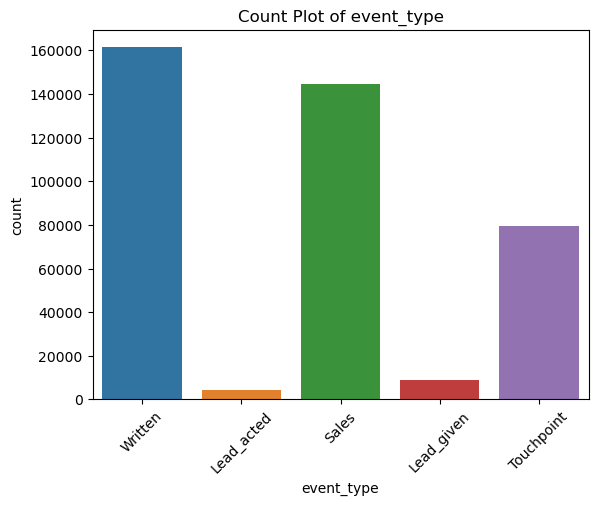

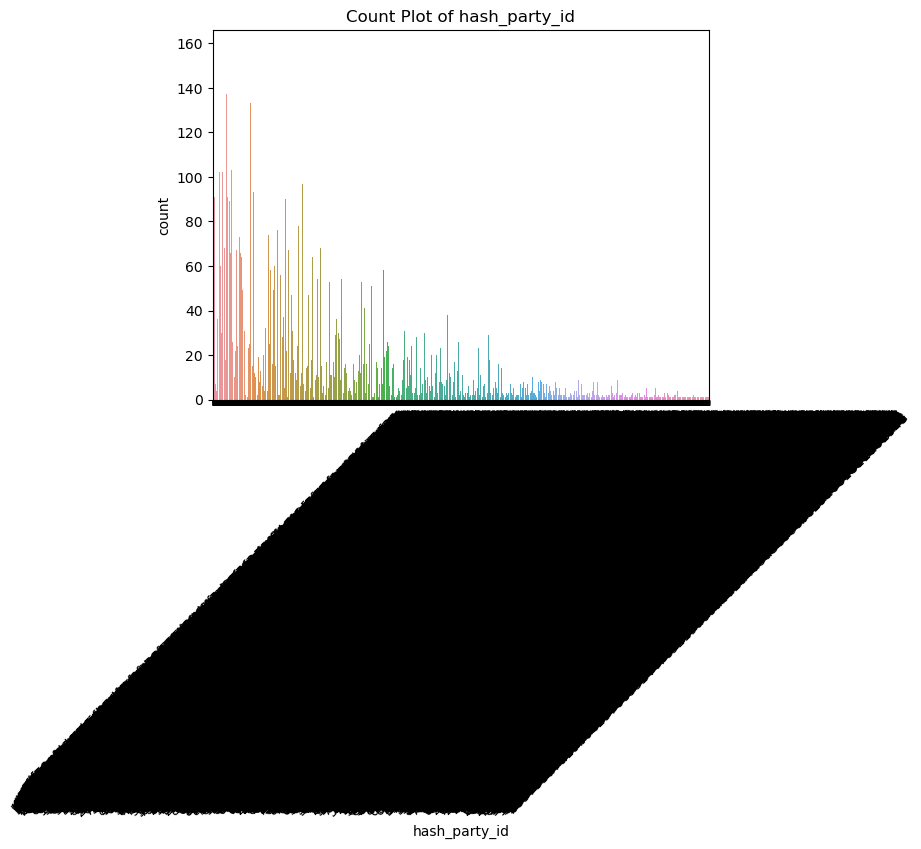

In [ ]:
categorical_columns = df.select_dtypes(include=['object']).columns
for column in categorical_columns:
    sns.countplot(x=df[column])
    plt.title(f'Count Plot of {column}')
    plt.xticks(rotation=45)
    plt.show()


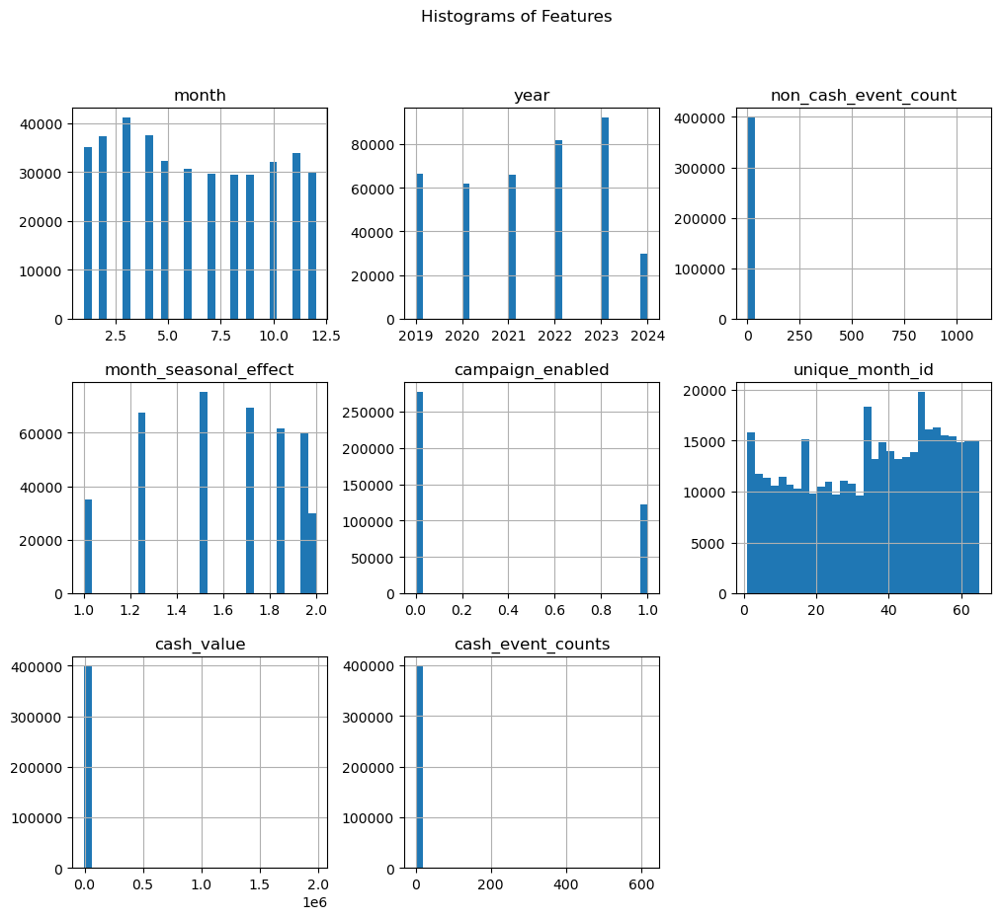

/var/folders/3n/4kw1v2fs2k96k4019mh5f4cw0000gn/T/ipykernel_98835/3170953676.py:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True)


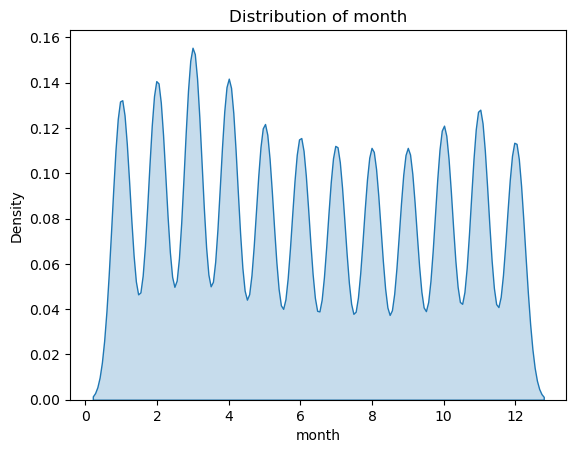

/var/folders/3n/4kw1v2fs2k96k4019mh5f4cw0000gn/T/ipykernel_98835/3170953676.py:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True)


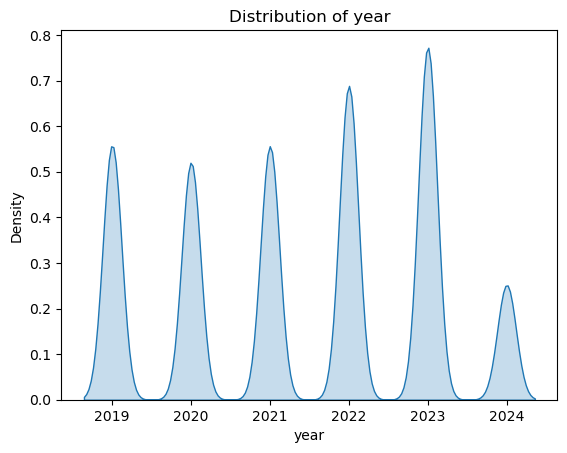

/var/folders/3n/4kw1v2fs2k96k4019mh5f4cw0000gn/T/ipykernel_98835/3170953676.py:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True)


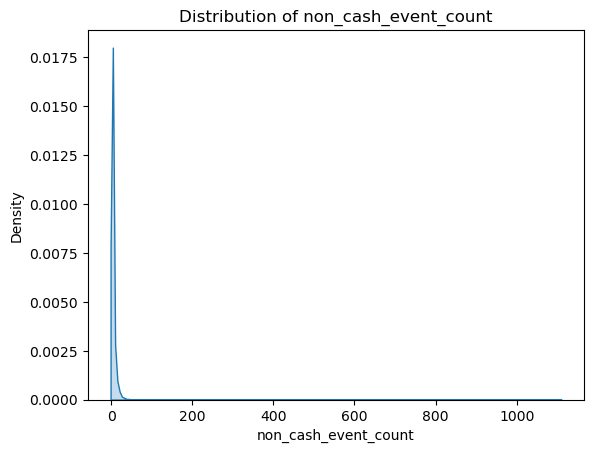

/var/folders/3n/4kw1v2fs2k96k4019mh5f4cw0000gn/T/ipykernel_98835/3170953676.py:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True)


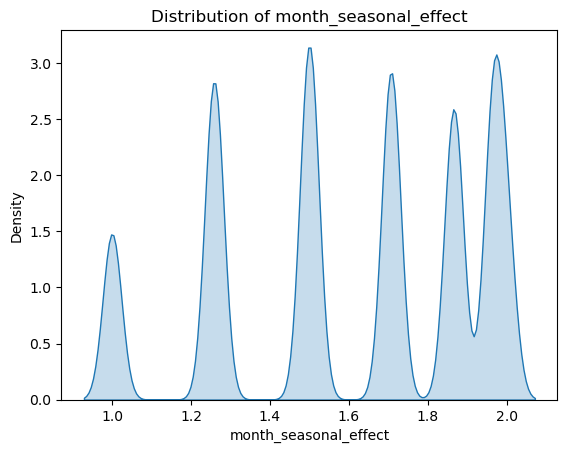

/var/folders/3n/4kw1v2fs2k96k4019mh5f4cw0000gn/T/ipykernel_98835/3170953676.py:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True)


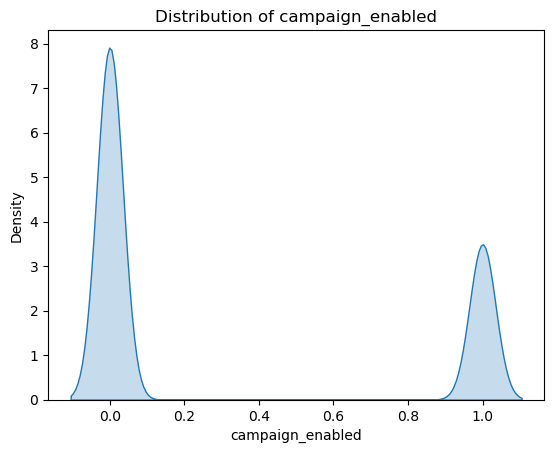

/var/folders/3n/4kw1v2fs2k96k4019mh5f4cw0000gn/T/ipykernel_98835/3170953676.py:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True)


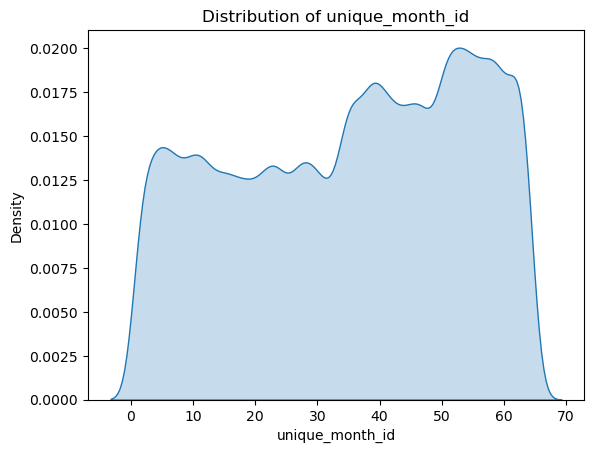

/var/folders/3n/4kw1v2fs2k96k4019mh5f4cw0000gn/T/ipykernel_98835/3170953676.py:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True)


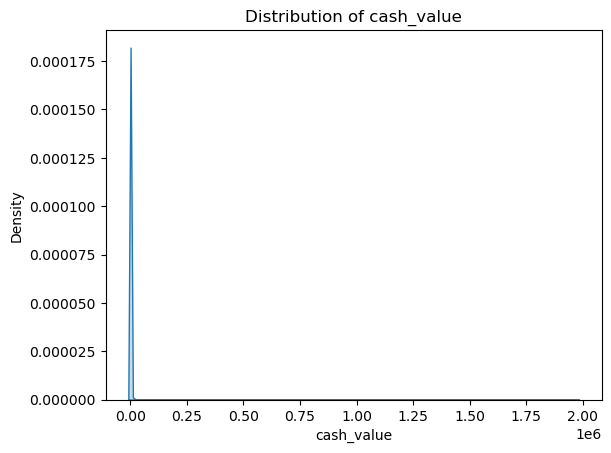

/var/folders/3n/4kw1v2fs2k96k4019mh5f4cw0000gn/T/ipykernel_98835/3170953676.py:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True)


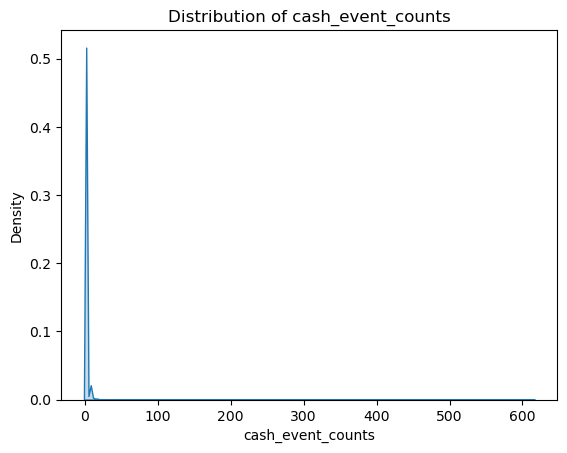

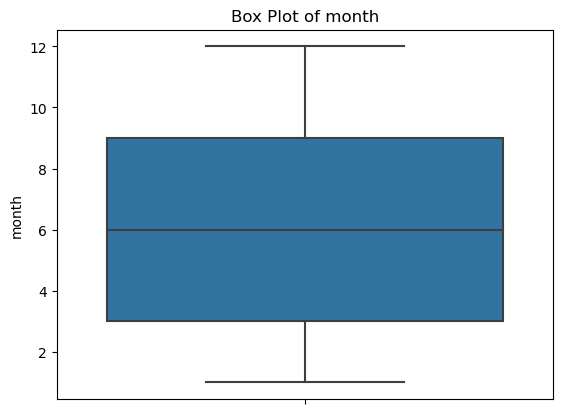

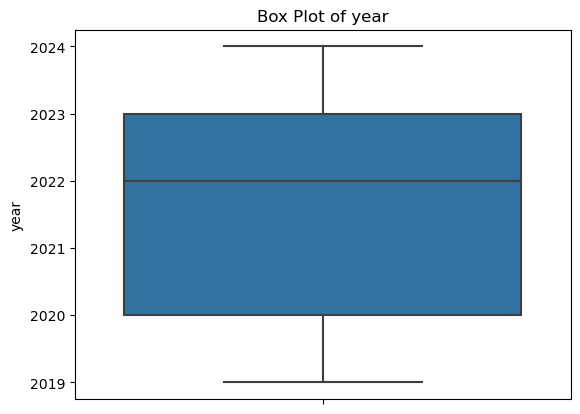

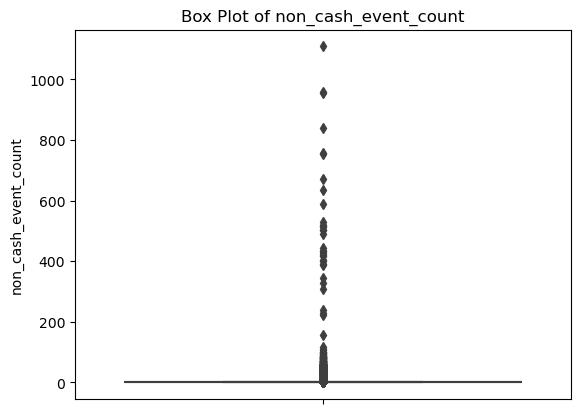

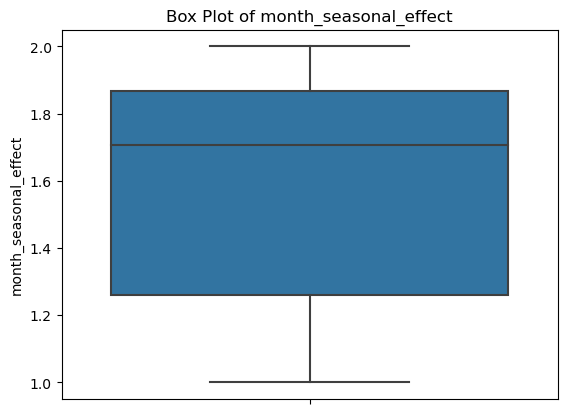

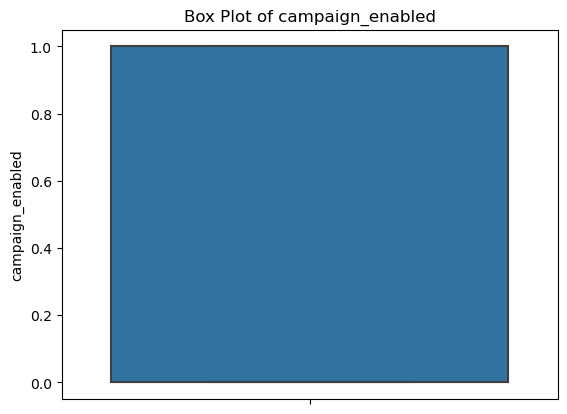

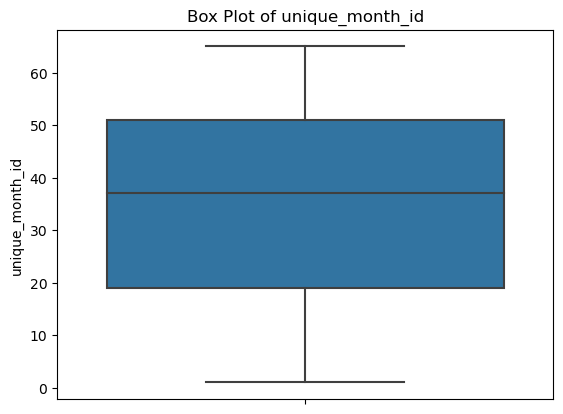

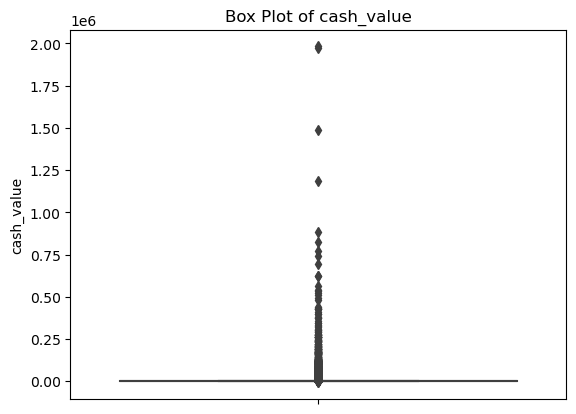

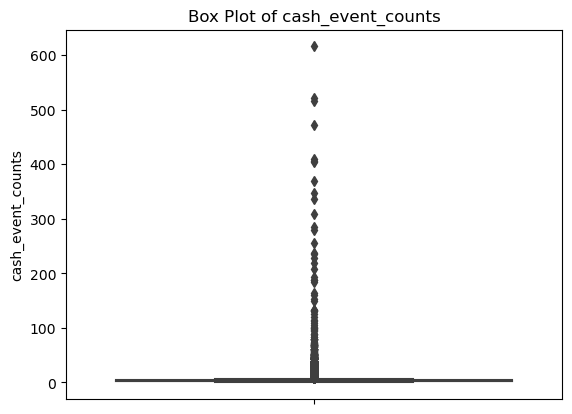

In [ ]:
# Histograms
df.hist(figsize=(12, 10), bins=30)
plt.suptitle('Histograms of Features')
plt.show()

# KDE plots
for column in df.select_dtypes(include=['float64', 'int64']).columns:
    sns.kdeplot(df[column], shade=True)
    plt.title(f'Distribution of {column}')
    plt.show()

# Box plots
for column in df.select_dtypes(include=['float64', 'int64']).columns:
    sns.boxplot(y=df[column])
    plt.title(f'Box Plot of {column}')
    plt.show()
